# **PREDICTING CREDIT FRAUD DETECTION**

In [ ]:
# importing necessary libraries 
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# loading the dataset 
df = pd.read_csv(r'fraudTrain.csv')

In [ ]:
# displaying the first five rows of the dataset
df.head()

,Unnamed: 0,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
0,0,2019-01-01 00:00:18,2703186189652095,"fraud_Rippin, Kub and Mann",misc_net,4.97,Jennifer,Banks,F,561 Perry Cove,...,36.0788,-81.1781,3495,"Psychologist, counselling",1988-03-09,0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0
1,1,2019-01-01 00:00:44,630423337322,"fraud_Heller, Gutmann and Zieme",grocery_pos,107.23,Stephanie,Gill,F,43039 Riley Greens Suite 393,...,48.8878,-118.2105,149,Special educational needs teacher,1978-06-21,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0
2,2,2019-01-01 00:00:51,38859492057661,fraud_Lind-Buckridge,entertainment,220.11,Edward,Sanchez,M,594 White Dale Suite 530,...,42.1808,-112.2620,4154,Nature conservation officer,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0
3,3,2019-01-01 00:01:16,3534093764340240,"fraud_Kutch, Hermiston and Farrell",gas_transport,45.00,Jeremy,White,M,9443 Cynthia Court Apt. 038,...,46.2306,-112.1138,1939,Patent attorney,1967-01-12,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0
4,4,2019-01-01 00:03:06,375534208663984,fraud_Keeling-Crist,misc_pos,41.96,Tyler,Garcia,M,408 Bradley Rest,...,38.4207,-79.4629,99,Dance movement psychotherapist,1986-03-28,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0


In [ ]:
# displaying last 5 records of the dataset
df.tail()

,Unnamed: 0,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
1296670,1296670,2020-06-21 12:12:08,30263540414123,fraud_Reichel Inc,entertainment,15.56,Erik,Patterson,M,162 Jessica Row Apt. 072,...,37.7175,-112.4777,258,Geoscientist,1961-11-24,440b587732da4dc1a6395aba5fb41669,1371816728,36.841266,-111.690765,0
1296671,1296671,2020-06-21 12:12:19,6011149206456997,fraud_Abernathy and Sons,food_dining,51.70,Jeffrey,White,M,8617 Holmes Terrace Suite 651,...,39.2667,-77.5101,100,"Production assistant, television",1979-12-11,278000d2e0d2277d1de2f890067dcc0a,1371816739,38.906881,-78.246528,0
1296672,1296672,2020-06-21 12:12:32,3514865930894695,fraud_Stiedemann Ltd,food_dining,105.93,Christopher,Castaneda,M,1632 Cohen Drive Suite 639,...,32.9396,-105.8189,899,Naval architect,1967-08-30,483f52fe67fabef353d552c1e662974c,1371816752,33.619513,-105.130529,0
1296673,1296673,2020-06-21 12:13:36,2720012583106919,"fraud_Reinger, Weissnat and Strosin",food_dining,74.90,Joseph,Murray,M,42933 Ryan Underpass,...,43.3526,-102.5411,1126,Volunteer coordinator,1980-08-18,d667cdcbadaaed3da3f4020e83591c83,1371816816,42.788940,-103.241160,0
1296674,1296674,2020-06-21 12:13:37,4292902571056973207,"fraud_Langosh, Wintheiser and Hyatt",food_dining,4.30,Jeffrey,Smith,M,135 Joseph Mountains,...,45.8433,-113.8748,218,"Therapist, horticultural",1995-08-16,8f7c8e4ab7f25875d753b422917c98c9,1371816817,46.565983,-114.186110,0


# **Exploratory Data Analysis (EDA)**

In [ ]:
# Let's check the shape of the dataset
df.shape

(1296675, 23)

In [ ]:
# checking the information of the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1296675 entries, 0 to 1296674
Data columns (total 23 columns):
 #   Column                 Non-Null Count    Dtype  
---  ------                 --------------    -----  
 0   Unnamed: 0             1296675 non-null  int64  
 1   trans_date_trans_time  1296675 non-null  object 
 2   cc_num                 1296675 non-null  int64  
 3   merchant               1296675 non-null  object 
 4   category               1296675 non-null  object 
 5   amt                    1296675 non-null  float64
 6   first                  1296675 non-null  object 
 7   last                   1296675 non-null  object 
 8   gender                 1296675 non-null  object 
 9   street                 1296675 non-null  object 
 10  city                   1296675 non-null  object 
 11  state                  1296675 non-null  object 
 12  zip                    1296675 non-null  int64  
 13  lat                    1296675 non-null  float64
 14  long              

In [ ]:
# getting the columns of the dataset
df.columns

Index(['Unnamed: 0', 'trans_date_trans_time', 'cc_num', 'merchant', 'category',
       'amt', 'first', 'last', 'gender', 'street', 'city', 'state', 'zip',
       'lat', 'long', 'city_pop', 'job', 'dob', 'trans_num', 'unix_time',
       'merch_lat', 'merch_long', 'is_fraud'],
      dtype='object')

In [ ]:
#suparate the values 
df_filterd_0=df[df['is_fraud']== 0]
df_filterd_1=df[df['is_fraud']== 1]
df_filterd_1

,Unnamed: 0,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
2449,2449,2019-01-02 01:06:37,4613314721966,fraud_Rutherford-Mertz,grocery_pos,281.06,Jason,Murphy,M,542 Steve Curve Suite 011,...,35.9946,-81.7266,885,Soil scientist,1988-09-15,e8a81877ae9a0a7f883e15cb39dc4022,1325466397,36.430124,-81.179483,1
2472,2472,2019-01-02 01:47:29,340187018810220,"fraud_Jenkins, Hauck and Friesen",gas_transport,11.52,Misty,Hart,F,27954 Hall Mill Suite 575,...,29.4400,-98.4590,1595797,Horticultural consultant,1960-10-28,bc7d41c41103877b03232f03f1f8d3f5,1325468849,29.819364,-99.142791,1
2523,2523,2019-01-02 03:05:23,340187018810220,fraud_Goodwin-Nitzsche,grocery_pos,276.31,Misty,Hart,F,27954 Hall Mill Suite 575,...,29.4400,-98.4590,1595797,Horticultural consultant,1960-10-28,b98f12f4168391b2203238813df5aa8c,1325473523,29.273085,-98.836360,1
2546,2546,2019-01-02 03:38:03,4613314721966,fraud_Erdman-Kertzmann,gas_transport,7.03,Jason,Murphy,M,542 Steve Curve Suite 011,...,35.9946,-81.7266,885,Soil scientist,1988-09-15,397894a5c4c02e3c61c784001f0f14e4,1325475483,35.909292,-82.091010,1
2553,2553,2019-01-02 03:55:47,340187018810220,fraud_Koepp-Parker,grocery_pos,275.73,Misty,Hart,F,27954 Hall Mill Suite 575,...,29.4400,-98.4590,1595797,Horticultural consultant,1960-10-28,7863235a750d73a244c07f1fb7f0185a,1325476547,29.786426,-98.683410,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1295399,1295399,2020-06-21 01:00:08,3524574586339330,fraud_Kassulke PLC,shopping_net,977.01,Ashley,Cabrera,F,94225 Smith Springs Apt. 617,...,27.6330,-80.4031,105638,"Librarian, public",1986-05-07,a83b093f0c1d9068fa0089f7c722615f,1371776408,26.888686,-80.834389,1
1295491,1295491,2020-06-21 01:53:35,3524574586339330,fraud_Schumm PLC,shopping_net,1210.91,Ashley,Cabrera,F,94225 Smith Springs Apt. 617,...,27.6330,-80.4031,105638,"Librarian, public",1986-05-07,f75b35bed13b9e692f170dba45a15b21,1371779615,28.216707,-79.855648,1
1295532,1295532,2020-06-21 02:16:56,4005676619255478,"fraud_Tillman, Dickinson and Labadie",gas_transport,10.24,William,Perry,M,458 Phillips Island Apt. 768,...,30.4590,-90.9027,71335,Herbalist,1994-05-31,a0ba2472cd3fc9731f2a18d3f308f5c3,1371781016,29.700456,-91.361632,1
1295666,1295666,2020-06-21 03:26:20,3560725013359375,fraud_Corwin-Collins,gas_transport,21.69,Brooke,Smith,F,63542 Luna Brook Apt. 012,...,31.8599,-102.7413,23,Cytogeneticist,1969-09-15,daa281350b1e16093c7b4bf97bf4d6ed,1371785180,32.675272,-103.484949,1


In [ ]:
df_filterd_0 = df_filterd_0[:200000]

In [ ]:
#cancating the both data
df=pd.concat([df_filterd_0,df_filterd_1])

In [ ]:
#checking the unique values in the dataset
df['is_fraud'].value_counts()

0    200000
1      7506
Name: is_fraud, dtype: int64

In [ ]:
#checking the null values
df.isnull().sum()

Unnamed: 0               0
trans_date_trans_time    0
cc_num                   0
merchant                 0
category                 0
amt                      0
first                    0
last                     0
gender                   0
street                   0
city                     0
state                    0
zip                      0
lat                      0
long                     0
city_pop                 0
job                      0
dob                      0
trans_num                0
unix_time                0
merch_lat                0
merch_long               0
is_fraud                 0
dtype: int64

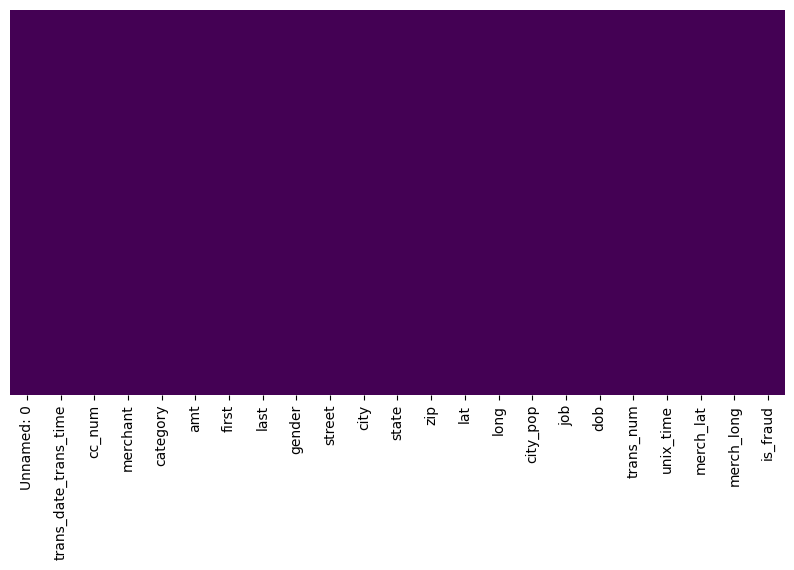

In [ ]:
# plot the line plot to show the no null  values
plt.figure(figsize=(10,5))
sns.heatmap(df.isnull(),yticklabels=False,cbar=False,cmap='viridis')
plt.show()

In [ ]:
import plotly.express as px
px.histogram(df,'is_fraud',facet_col='gender', color='is_fraud', marginal='rug')

In [ ]:
df['category'].value_counts()

gas_transport     20952
grocery_pos       20580
home              19284
shopping_pos      18873
kids_pets         17591
shopping_net      16716
entertainment     14750
food_dining       14368
personal_care     14218
health_fitness    13626
misc_pos          12470
misc_net          10574
grocery_net        7120
travel             6384
Name: category, dtype: int64

In [ ]:
#descriptive statististics for categorical columns
df.describe(include = 'object')

,trans_date_trans_time,merchant,category,first,last,gender,street,city,state,job,dob,trans_num
count,207506,207506,207506,207506,207506,207506,207506,207506,207506,207506,207506,207506
unique,204782,693,14,352,481,2,983,894,51,494,968,207506
top,2019-03-25 22:40:32,fraud_Kilback LLC,gas_transport,Christopher,Smith,F,40624 Rebecca Spurs,Birmingham,TX,Exhibition designer,1977-03-23,0b242abb623afc578575680df30655b9
freq,3,705,20952,4402,4494,113233,539,869,15113,1523,869,1


In [ ]:
df.shape

(207506, 23)

In [ ]:
# statistical summary of the dataset
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,207506.0,1.198729e+05,1.366035e+05,0.000000e+00,5.187625e+04,1.037525e+05,1.556288e+05,1.295733e+06
cc_num,207506.0,4.150159e+17,1.305423e+18,6.041621e+10,1.800365e+14,3.520550e+15,4.642255e+15,4.992346e+18
amt,207506.0,8.426471e+01,1.886836e+02,1.000000e+00,9.860000e+00,4.874000e+01,8.678000e+01,1.789724e+04
zip,207506.0,4.876352e+04,2.690242e+04,1.257000e+03,2.604100e+04,4.815400e+04,7.201100e+04,9.978300e+04
lat,207506.0,3.853555e+01,5.066136e+00,2.002710e+01,3.466890e+01,3.935430e+01,4.189480e+01,6.669330e+01
long,207506.0,-9.018861e+01,1.374785e+01,-1.656723e+02,-9.679090e+01,-8.745810e+01,-8.015800e+01,-6.795030e+01
city_pop,207506.0,9.039081e+04,3.061089e+05,2.300000e+01,7.430000e+02,2.457000e+03,2.112500e+04,2.906700e+06
unix_time,207506.0,1.330839e+09,4.995335e+06,1.325376e+09,1.328017e+09,1.330628e+09,1.332592e+09,1.371787e+09
merch_lat,207506.0,3.853668e+01,5.101137e+00,1.902980e+01,3.474581e+01,3.935729e+01,4.195115e+01,6.751027e+01
merch_long,207506.0,-9.018901e+01,1.375969e+01,-1.666712e+02,-9.685874e+01,-8.740691e+01,-8.021735e+01,-6.696774e+01


In [ ]:
# checking the unique values of the dataset
df.nunique()

Unnamed: 0               207506
trans_date_trans_time    204782
cc_num                      983
merchant                    693
category                     14
amt                       30914
first                       352
last                        481
gender                        2
street                      983
city                        894
state                        51
zip                         970
lat                         968
long                        969
city_pop                    879
job                         494
dob                         968
trans_num                207506
unix_time                204814
merch_lat                206244
merch_long               206959
is_fraud                      2
dtype: int64

In [ ]:
import plotly 
import plotly.express as px
#Number of Unique Values
unique_values= df.select_dtypes(include='number').nunique()

fig = px.bar(unique_values, title='Number of Unique Values', labels = {'x':'', 'y':'Features'}, log_y=True)
fig.update_xaxes(categoryorder='total descending')
fig.update_layout(showlegend=False)

In [ ]:
#Check Number of Duplicates
n_duplicates = df.duplicated().sum()
print(f'We have {n_duplicates} duplicates in our dataset')

We have 0 duplicates in our dataset


<Axes: xlabel='category', ylabel='count'>

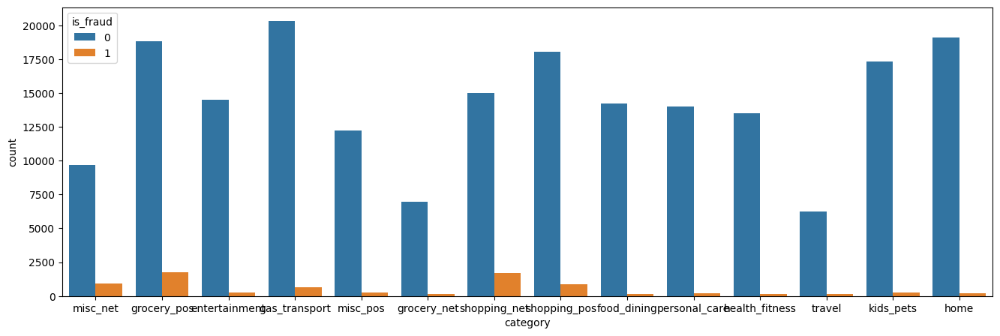

In [ ]:
# plot the comparison plot for department and ispromoted columns 
plt.figure(figsize=(16,5))
sns.countplot(x='category',hue='is_fraud',data=df)

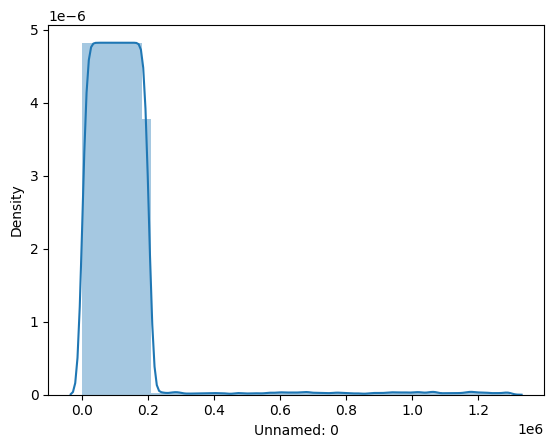

<Figure size 600x600 with 0 Axes>

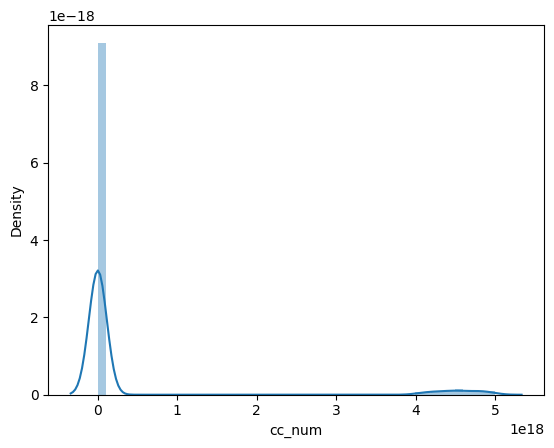

<Figure size 600x600 with 0 Axes>

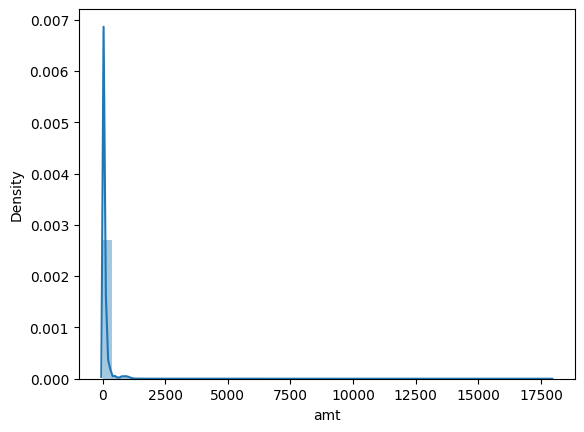

<Figure size 600x600 with 0 Axes>

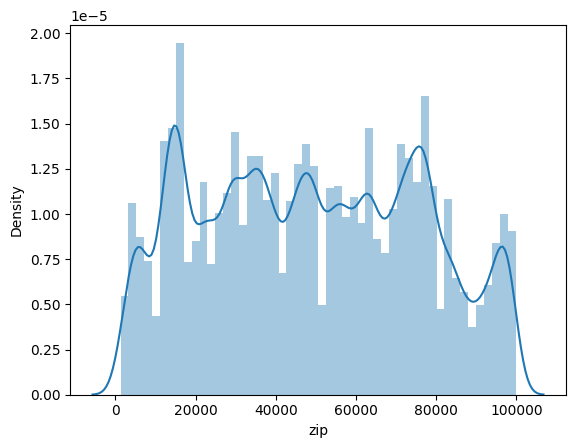

<Figure size 600x600 with 0 Axes>

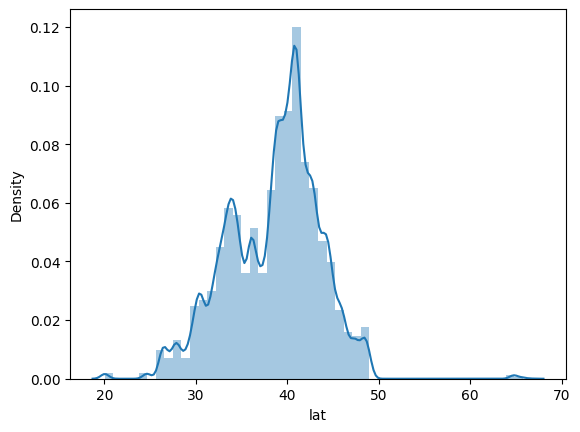

<Figure size 600x600 with 0 Axes>

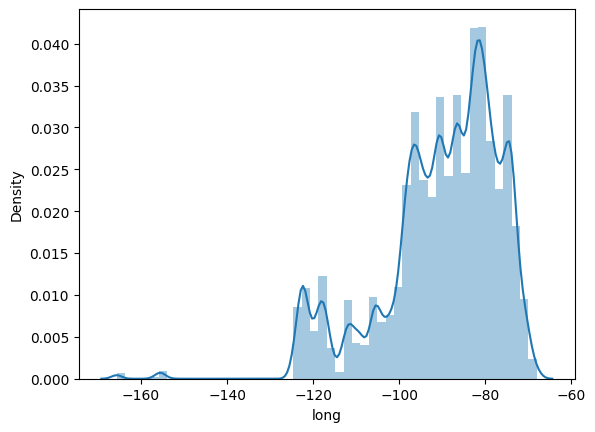

<Figure size 600x600 with 0 Axes>

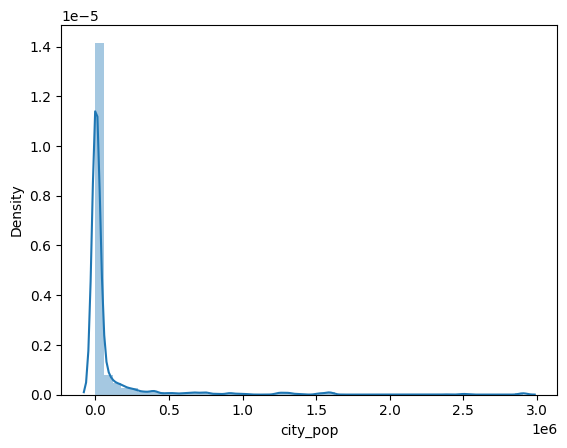

<Figure size 600x600 with 0 Axes>

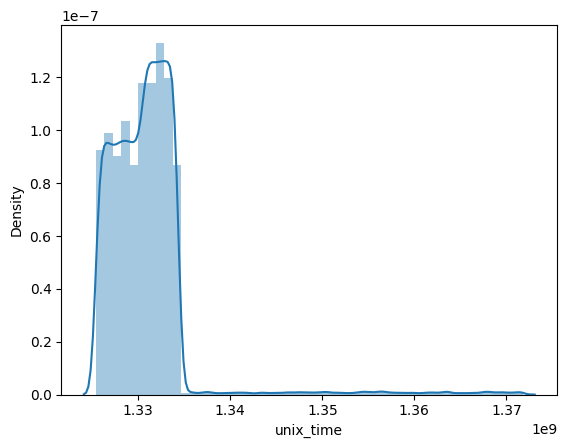

<Figure size 600x600 with 0 Axes>

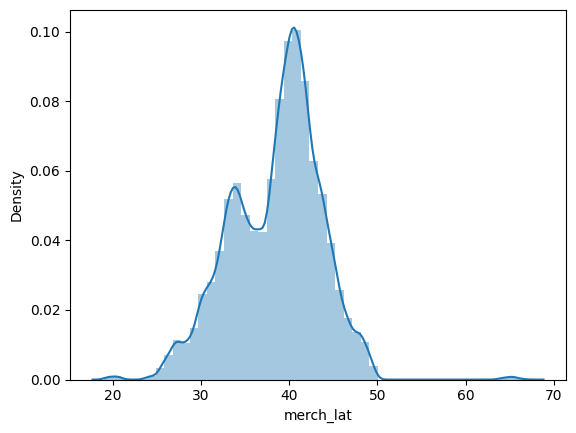

<Figure size 600x600 with 0 Axes>

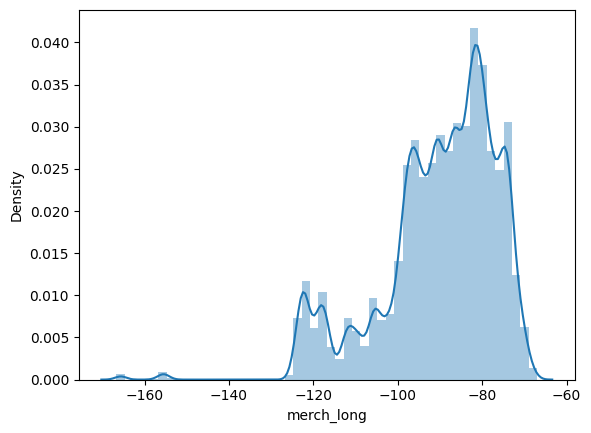

<Figure size 600x600 with 0 Axes>

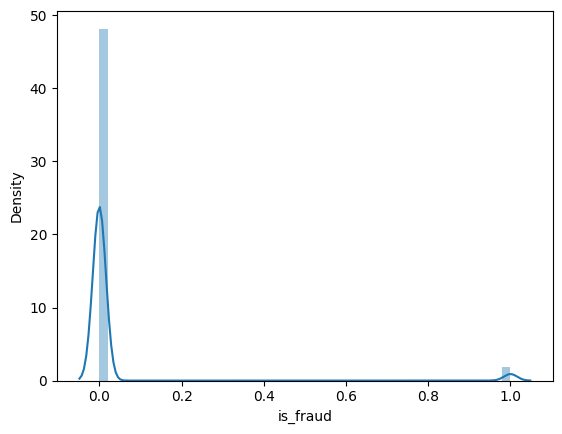

<Figure size 600x600 with 0 Axes>

In [ ]:
# write a for loop to print the density plot for each numerical column
for i in df.select_dtypes(include=np.number).columns:
    sns.distplot(df[i])
    plt.figure(figsize=(6,6))
    plt.show()


In [ ]:
px.sunburst(df,path=[ 'gender','category'], values='is_fraud')

<Axes: xlabel='category', ylabel='merch_lat'>

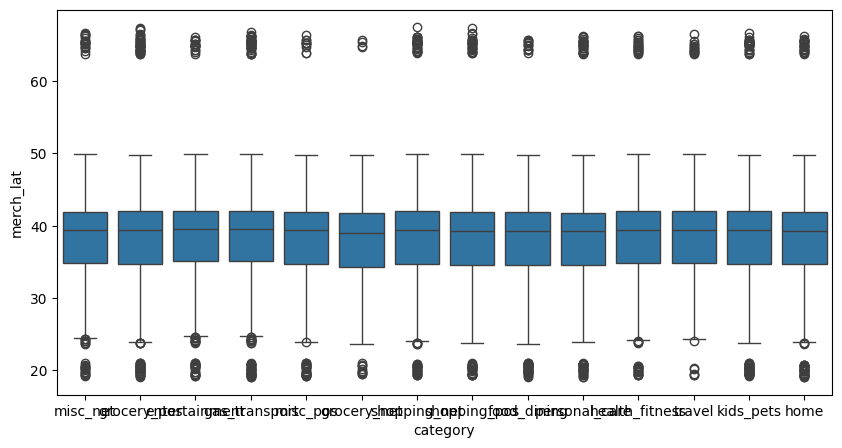

In [ ]:
# plot the box plot for the age and is  columns
plt.figure(figsize=(10,5))

sns.boxplot(x='category',y='merch_lat',data=df)

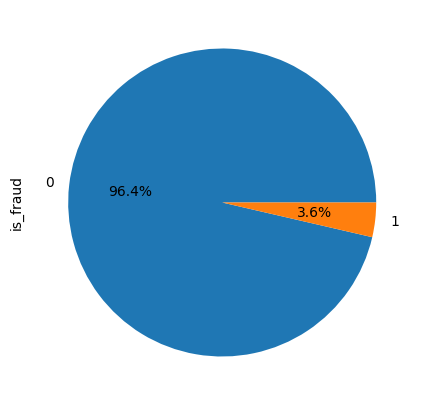

In [ ]:
# plotign the donut plot for the awards_won and is promoted columns
plt.figure(figsize=(10,5))
df['is_fraud'].value_counts().plot.pie(autopct='%1.1f%%')
plt.show()

<Axes: ylabel='category'>

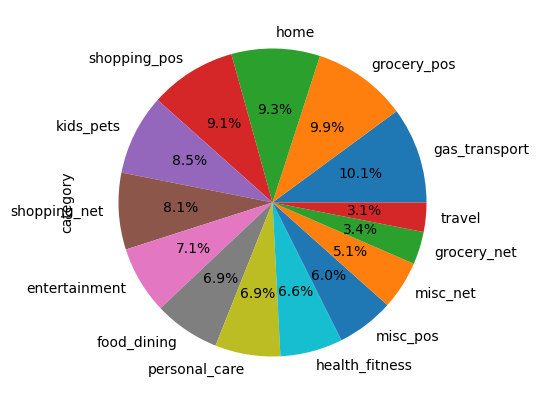

In [ ]:
# plot the pie plot for the previous_year_rating column
plt.figure(figsize=(10,5))
df['category'].value_counts().plot.pie(autopct='%1.1f%%')

# **Data preprocessing**

In [ ]:
## finding the top 5 citys colmnns
top_5 = df['city'].value_counts().nlargest(6).index.tolist()

# Create a new column 'TopItems' with their names
df['top_5_city'] = df['city'].apply(lambda x: x if x in top_5 else 'Other')

print(df)

         Unnamed: 0 trans_date_trans_time            cc_num  \
0                 0   2019-01-01 00:00:18  2703186189652095   
1                 1   2019-01-01 00:00:44      630423337322   
2                 2   2019-01-01 00:00:51    38859492057661   
3                 3   2019-01-01 00:01:16  3534093764340240   
4                 4   2019-01-01 00:03:06   375534208663984   
...             ...                   ...               ...   
1295399     1295399   2020-06-21 01:00:08  3524574586339330   
1295491     1295491   2020-06-21 01:53:35  3524574586339330   
1295532     1295532   2020-06-21 02:16:56  4005676619255478   
1295666     1295666   2020-06-21 03:26:20  3560725013359375   
1295733     1295733   2020-06-21 03:59:46  4005676619255478   

                                     merchant       category      amt  \
0                  fraud_Rippin, Kub and Mann       misc_net     4.97   
1             fraud_Heller, Gutmann and Zieme    grocery_pos   107.23   
2                       

In [ ]:
df['top_5_city'].value_counts()

Other          202581
Birmingham        869
Utica             832
Meridian          827
San Antonio       824
Phoenix           816
Conway            757
Name: top_5_city, dtype: int64

In [ ]:
## finding the top5 in job colummn
top_5 = df['job'].value_counts().nlargest(6).index.tolist()

# Create a new column 'TopItems' with their names
df['top_5_job'] = df['job'].apply(lambda x: x if x in top_5 else 'Other')

print(df)

         Unnamed: 0 trans_date_trans_time            cc_num  \
0                 0   2019-01-01 00:00:18  2703186189652095   
1                 1   2019-01-01 00:00:44      630423337322   
2                 2   2019-01-01 00:00:51    38859492057661   
3                 3   2019-01-01 00:01:16  3534093764340240   
4                 4   2019-01-01 00:03:06   375534208663984   
...             ...                   ...               ...   
1295399     1295399   2020-06-21 01:00:08  3524574586339330   
1295491     1295491   2020-06-21 01:53:35  3524574586339330   
1295532     1295532   2020-06-21 02:16:56  4005676619255478   
1295666     1295666   2020-06-21 03:26:20  3560725013359375   
1295733     1295733   2020-06-21 03:59:46  4005676619255478   

                                     merchant       category      amt  \
0                  fraud_Rippin, Kub and Mann       misc_net     4.97   
1             fraud_Heller, Gutmann and Zieme    grocery_pos   107.23   
2                       

In [ ]:
df['top_5_job'].value_counts().to_dict()

{'Other': 199119,
 'Exhibition designer': 1523,
 'Film/video editor': 1501,
 'Surveyor, land/geomatics': 1397,
 'Naval architect': 1389,
 'Materials engineer': 1306,
 'Systems developer': 1271}

In [ ]:
## ffinding the top 6 in marchan columns
top_5 = df['merchant'].value_counts().nlargest(6).index.tolist()

# Create a new column 'TopItems' with their names
df['top_5_in_merchant'] = df['merchant'].apply(lambda x: x if x in top_5 else 'Other')

# Display the DataFrame
print(df)

         Unnamed: 0 trans_date_trans_time            cc_num  \
0                 0   2019-01-01 00:00:18  2703186189652095   
1                 1   2019-01-01 00:00:44      630423337322   
2                 2   2019-01-01 00:00:51    38859492057661   
3                 3   2019-01-01 00:01:16  3534093764340240   
4                 4   2019-01-01 00:03:06   375534208663984   
...             ...                   ...               ...   
1295399     1295399   2020-06-21 01:00:08  3524574586339330   
1295491     1295491   2020-06-21 01:53:35  3524574586339330   
1295532     1295532   2020-06-21 02:16:56  4005676619255478   
1295666     1295666   2020-06-21 03:26:20  3560725013359375   
1295733     1295733   2020-06-21 03:59:46  4005676619255478   

                                     merchant       category      amt  \
0                  fraud_Rippin, Kub and Mann       misc_net     4.97   
1             fraud_Heller, Gutmann and Zieme    grocery_pos   107.23   
2                       

In [ ]:
df['top_5_in_merchant'].value_counts()

Other                  203892
fraud_Kilback LLC         705
fraud_Cormier LLC         630
fraud_Schumm PLC          614
fraud_Boyer PLC           568
fraud_Kuhn LLC            551
fraud_Dickinson Ltd       546
Name: top_5_in_merchant, dtype: int64

In [ ]:
top_6_repeated = df['merchant'].value_counts().head(6)
top_6_repeated


fraud_Kilback LLC      705
fraud_Cormier LLC      630
fraud_Schumm PLC       614
fraud_Boyer PLC        568
fraud_Kuhn LLC         551
fraud_Dickinson Ltd    546
Name: merchant, dtype: int64

In [ ]:
df

,Unnamed: 0,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,...,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud,top_5_city,top_5_job,top_5_in_merchant
0,0,2019-01-01 00:00:18,2703186189652095,"fraud_Rippin, Kub and Mann",misc_net,4.97,Jennifer,Banks,F,561 Perry Cove,...,"Psychologist, counselling",1988-03-09,0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0,Other,Other,Other
1,1,2019-01-01 00:00:44,630423337322,"fraud_Heller, Gutmann and Zieme",grocery_pos,107.23,Stephanie,Gill,F,43039 Riley Greens Suite 393,...,Special educational needs teacher,1978-06-21,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0,Other,Other,Other
2,2,2019-01-01 00:00:51,38859492057661,fraud_Lind-Buckridge,entertainment,220.11,Edward,Sanchez,M,594 White Dale Suite 530,...,Nature conservation officer,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0,Other,Other,Other
3,3,2019-01-01 00:01:16,3534093764340240,"fraud_Kutch, Hermiston and Farrell",gas_transport,45.00,Jeremy,White,M,9443 Cynthia Court Apt. 038,...,Patent attorney,1967-01-12,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0,Other,Other,Other
4,4,2019-01-01 00:03:06,375534208663984,fraud_Keeling-Crist,misc_pos,41.96,Tyler,Garcia,M,408 Bradley Rest,...,Dance movement psychotherapist,1986-03-28,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0,Other,Other,Other
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1295399,1295399,2020-06-21 01:00:08,3524574586339330,fraud_Kassulke PLC,shopping_net,977.01,Ashley,Cabrera,F,94225 Smith Springs Apt. 617,...,"Librarian, public",1986-05-07,a83b093f0c1d9068fa0089f7c722615f,1371776408,26.888686,-80.834389,1,Other,Other,Other
1295491,1295491,2020-06-21 01:53:35,3524574586339330,fraud_Schumm PLC,shopping_net,1210.91,Ashley,Cabrera,F,94225 Smith Springs Apt. 617,...,"Librarian, public",1986-05-07,f75b35bed13b9e692f170dba45a15b21,1371779615,28.216707,-79.855648,1,Other,Other,fraud_Schumm PLC
1295532,1295532,2020-06-21 02:16:56,4005676619255478,"fraud_Tillman, Dickinson and Labadie",gas_transport,10.24,William,Perry,M,458 Phillips Island Apt. 768,...,Herbalist,1994-05-31,a0ba2472cd3fc9731f2a18d3f308f5c3,1371781016,29.700456,-91.361632,1,Other,Other,Other
1295666,1295666,2020-06-21 03:26:20,3560725013359375,fraud_Corwin-Collins,gas_transport,21.69,Brooke,Smith,F,63542 Luna Brook Apt. 012,...,Cytogeneticist,1969-09-15,daa281350b1e16093c7b4bf97bf4d6ed,1371785180,32.675272,-103.484949,1,Other,Other,Other


In [ ]:
## calucualate the age in using the column
from datetime import datetime
df['dob'] = pd.to_datetime(df['dob'])
def calculate_age(born):
    today = datetime.today()
    return today.year - born.year - ((today.month, today.day) < (born.month, born.day))

# Apply the function to create an 'Age' column
df['Age'] = df['dob'].apply(calculate_age)


In [ ]:
df

,Unnamed: 0,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,...,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud,top_5_city,top_5_job,top_5_in_merchant,Age
0,0,2019-01-01 00:00:18,2703186189652095,"fraud_Rippin, Kub and Mann",misc_net,4.97,Jennifer,Banks,F,561 Perry Cove,...,1988-03-09,0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0,Other,Other,Other,36
1,1,2019-01-01 00:00:44,630423337322,"fraud_Heller, Gutmann and Zieme",grocery_pos,107.23,Stephanie,Gill,F,43039 Riley Greens Suite 393,...,1978-06-21,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0,Other,Other,Other,46
2,2,2019-01-01 00:00:51,38859492057661,fraud_Lind-Buckridge,entertainment,220.11,Edward,Sanchez,M,594 White Dale Suite 530,...,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0,Other,Other,Other,62
3,3,2019-01-01 00:01:16,3534093764340240,"fraud_Kutch, Hermiston and Farrell",gas_transport,45.00,Jeremy,White,M,9443 Cynthia Court Apt. 038,...,1967-01-12,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0,Other,Other,Other,57
4,4,2019-01-01 00:03:06,375534208663984,fraud_Keeling-Crist,misc_pos,41.96,Tyler,Garcia,M,408 Bradley Rest,...,1986-03-28,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0,Other,Other,Other,38
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1295399,1295399,2020-06-21 01:00:08,3524574586339330,fraud_Kassulke PLC,shopping_net,977.01,Ashley,Cabrera,F,94225 Smith Springs Apt. 617,...,1986-05-07,a83b093f0c1d9068fa0089f7c722615f,1371776408,26.888686,-80.834389,1,Other,Other,Other,38
1295491,1295491,2020-06-21 01:53:35,3524574586339330,fraud_Schumm PLC,shopping_net,1210.91,Ashley,Cabrera,F,94225 Smith Springs Apt. 617,...,1986-05-07,f75b35bed13b9e692f170dba45a15b21,1371779615,28.216707,-79.855648,1,Other,Other,fraud_Schumm PLC,38
1295532,1295532,2020-06-21 02:16:56,4005676619255478,"fraud_Tillman, Dickinson and Labadie",gas_transport,10.24,William,Perry,M,458 Phillips Island Apt. 768,...,1994-05-31,a0ba2472cd3fc9731f2a18d3f308f5c3,1371781016,29.700456,-91.361632,1,Other,Other,Other,30
1295666,1295666,2020-06-21 03:26:20,3560725013359375,fraud_Corwin-Collins,gas_transport,21.69,Brooke,Smith,F,63542 Luna Brook Apt. 012,...,1969-09-15,daa281350b1e16093c7b4bf97bf4d6ed,1371785180,32.675272,-103.484949,1,Other,Other,Other,54


In [ ]:
df.columns



Index(['Unnamed: 0', 'trans_date_trans_time', 'cc_num', 'merchant', 'category',
       'amt', 'first', 'last', 'gender', 'street', 'city', 'state', 'zip',
       'lat', 'long', 'city_pop', 'job', 'dob', 'trans_num', 'unix_time',
       'merch_lat', 'merch_long', 'is_fraud', 'top_5_city', 'top_5_job',
       'top_5_in_merchant', 'Age'],
      dtype='object')

In [ ]:
## droping the columns 
data =df.drop(columns=['Unnamed: 0','trans_date_trans_time','merchant','dob','first','last','street','city'],axis=1)

In [ ]:
data

,cc_num,category,amt,gender,state,zip,lat,long,city_pop,job,trans_num,unix_time,merch_lat,merch_long,is_fraud,top_5_city,top_5_job,top_5_in_merchant,Age
0,2703186189652095,misc_net,4.97,F,NC,28654,36.0788,-81.1781,3495,"Psychologist, counselling",0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0,Other,Other,Other,36
1,630423337322,grocery_pos,107.23,F,WA,99160,48.8878,-118.2105,149,Special educational needs teacher,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0,Other,Other,Other,46
2,38859492057661,entertainment,220.11,M,ID,83252,42.1808,-112.2620,4154,Nature conservation officer,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0,Other,Other,Other,62
3,3534093764340240,gas_transport,45.00,M,MT,59632,46.2306,-112.1138,1939,Patent attorney,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0,Other,Other,Other,57
4,375534208663984,misc_pos,41.96,M,VA,24433,38.4207,-79.4629,99,Dance movement psychotherapist,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0,Other,Other,Other,38
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1295399,3524574586339330,shopping_net,977.01,F,FL,32960,27.6330,-80.4031,105638,"Librarian, public",a83b093f0c1d9068fa0089f7c722615f,1371776408,26.888686,-80.834389,1,Other,Other,Other,38
1295491,3524574586339330,shopping_net,1210.91,F,FL,32960,27.6330,-80.4031,105638,"Librarian, public",f75b35bed13b9e692f170dba45a15b21,1371779615,28.216707,-79.855648,1,Other,Other,fraud_Schumm PLC,38
1295532,4005676619255478,gas_transport,10.24,M,LA,70726,30.4590,-90.9027,71335,Herbalist,a0ba2472cd3fc9731f2a18d3f308f5c3,1371781016,29.700456,-91.361632,1,Other,Other,Other,30
1295666,3560725013359375,gas_transport,21.69,F,TX,79759,31.8599,-102.7413,23,Cytogeneticist,daa281350b1e16093c7b4bf97bf4d6ed,1371785180,32.675272,-103.484949,1,Other,Other,Other,54


In [ ]:
data.dtypes

cc_num                 int64
category              object
amt                  float64
gender                object
state                 object
zip                    int64
lat                  float64
long                 float64
city_pop               int64
job                   object
trans_num             object
unix_time              int64
merch_lat            float64
merch_long           float64
is_fraud               int64
top_5_city            object
top_5_job             object
top_5_in_merchant     object
Age                    int64
dtype: object

In [ ]:
## selcet the object columns for checking
for i in data.select_dtypes(include='object').columns:
    print(i)

category
gender
state
job
trans_num
top_5_city
top_5_job
top_5_in_merchant


In [ ]:
data['top_5_city'].value_counts()

Other          202581
Birmingham        869
Utica             832
Meridian          827
San Antonio       824
Phoenix           816
Conway            757
Name: top_5_city, dtype: int64

In [ ]:
## checking the data ofter top 5
data

,cc_num,category,amt,gender,state,zip,lat,long,city_pop,job,trans_num,unix_time,merch_lat,merch_long,is_fraud,top_5_city,top_5_job,top_5_in_merchant,Age
0,2703186189652095,misc_net,4.97,F,NC,28654,36.0788,-81.1781,3495,"Psychologist, counselling",0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0,Other,Other,Other,36
1,630423337322,grocery_pos,107.23,F,WA,99160,48.8878,-118.2105,149,Special educational needs teacher,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0,Other,Other,Other,46
2,38859492057661,entertainment,220.11,M,ID,83252,42.1808,-112.2620,4154,Nature conservation officer,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0,Other,Other,Other,62
3,3534093764340240,gas_transport,45.00,M,MT,59632,46.2306,-112.1138,1939,Patent attorney,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0,Other,Other,Other,57
4,375534208663984,misc_pos,41.96,M,VA,24433,38.4207,-79.4629,99,Dance movement psychotherapist,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0,Other,Other,Other,38
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1295399,3524574586339330,shopping_net,977.01,F,FL,32960,27.6330,-80.4031,105638,"Librarian, public",a83b093f0c1d9068fa0089f7c722615f,1371776408,26.888686,-80.834389,1,Other,Other,Other,38
1295491,3524574586339330,shopping_net,1210.91,F,FL,32960,27.6330,-80.4031,105638,"Librarian, public",f75b35bed13b9e692f170dba45a15b21,1371779615,28.216707,-79.855648,1,Other,Other,fraud_Schumm PLC,38
1295532,4005676619255478,gas_transport,10.24,M,LA,70726,30.4590,-90.9027,71335,Herbalist,a0ba2472cd3fc9731f2a18d3f308f5c3,1371781016,29.700456,-91.361632,1,Other,Other,Other,30
1295666,3560725013359375,gas_transport,21.69,F,TX,79759,31.8599,-102.7413,23,Cytogeneticist,daa281350b1e16093c7b4bf97bf4d6ed,1371785180,32.675272,-103.484949,1,Other,Other,Other,54


In [ ]:
### convert to object to numeric
from sklearn.preprocessing import LabelEncoder
# Initializing LabelEncoders for each column
label_encoders = {}
for column in data.columns:
    if data[column].dtypes == 'object':
        print(data[i])
        le = LabelEncoder()
        data[column] = le.fit_transform(data[column])
        label_encoders[column] = le

# Display encoded data
print("Encoded DataFrame:")
print(data)
data.to_csv('encod.csv')


0                     Other
1                     Other
2                     Other
3                     Other
4                     Other
                 ...       
1295399               Other
1295491    fraud_Schumm PLC
1295532               Other
1295666               Other
1295733               Other
Name: top_5_in_merchant, Length: 207506, dtype: object
0                     Other
1                     Other
2                     Other
3                     Other
4                     Other
                 ...       
1295399               Other
1295491    fraud_Schumm PLC
1295532               Other
1295666               Other
1295733               Other
Name: top_5_in_merchant, Length: 207506, dtype: object
0                     Other
1                     Other
2                     Other
3                     Other
4                     Other
                 ...       
1295399               Other
1295491    fraud_Schumm PLC
1295532               Other
1295666               

In [ ]:
### create the label for all
for col, encoder in label_encoders.items():
    print(f"Mapping for column '{col}':")
    for label, category in enumerate(encoder.classes_):
        print(f"Label {label}: {category}")

Mapping for column 'category':
Label 0: entertainment
Label 1: food_dining
Label 2: gas_transport
Label 3: grocery_net
Label 4: grocery_pos
Label 5: health_fitness
Label 6: home
Label 7: kids_pets
Label 8: misc_net
Label 9: misc_pos
Label 10: personal_care
Label 11: shopping_net
Label 12: shopping_pos
Label 13: travel
Mapping for column 'gender':
Label 0: F
Label 1: M
Mapping for column 'state':
Label 0: AK
Label 1: AL
Label 2: AR
Label 3: AZ
Label 4: CA
Label 5: CO
Label 6: CT
Label 7: DC
Label 8: DE
Label 9: FL
Label 10: GA
Label 11: HI
Label 12: IA
Label 13: ID
Label 14: IL
Label 15: IN
Label 16: KS
Label 17: KY
Label 18: LA
Label 19: MA
Label 20: MD
Label 21: ME
Label 22: MI
Label 23: MN
Label 24: MO
Label 25: MS
Label 26: MT
Label 27: NC
Label 28: ND
Label 29: NE
Label 30: NH
Label 31: NJ
Label 32: NM
Label 33: NV
Label 34: NY
Label 35: OH
Label 36: OK
Label 37: OR
Label 38: PA
Label 39: RI
Label 40: SC
Label 41: SD
Label 42: TN
Label 43: TX
Label 44: UT
Label 45: VA
Label 46: VT


In [ ]:
data['top_5_job'].value_counts()

4    199119
0      1523
1      1501
5      1397
3      1389
2      1306
6      1271
Name: top_5_job, dtype: int64

In [ ]:
ndata = pd.DataFrame(data)

In [ ]:
data.head()

,cc_num,category,amt,gender,state,zip,lat,long,city_pop,job,trans_num,unix_time,merch_lat,merch_long,is_fraud,top_5_city,top_5_job,top_5_in_merchant,Age
0,2703186189652095,8,4.97,0,27,28654,36.0788,-81.1781,3495,370,9005,1325376018,36.011293,-82.048315,0,3,4,0,36
1,630423337322,4,107.23,0,47,99160,48.8878,-118.2105,149,428,25455,1325376044,49.159047,-118.186462,0,3,4,0,46
2,38859492057661,0,220.11,1,13,83252,42.1808,-112.2620,4154,307,130650,1325376051,43.150704,-112.154481,0,3,4,0,62
3,3534093764340240,2,45.00,1,26,59632,46.2306,-112.1138,1939,328,86868,1325376076,47.034331,-112.561071,0,3,4,0,57
4,375534208663984,9,41.96,1,45,24433,38.4207,-79.4629,99,116,132621,1325376186,38.674999,-78.632459,0,3,4,0,38


<Axes: >

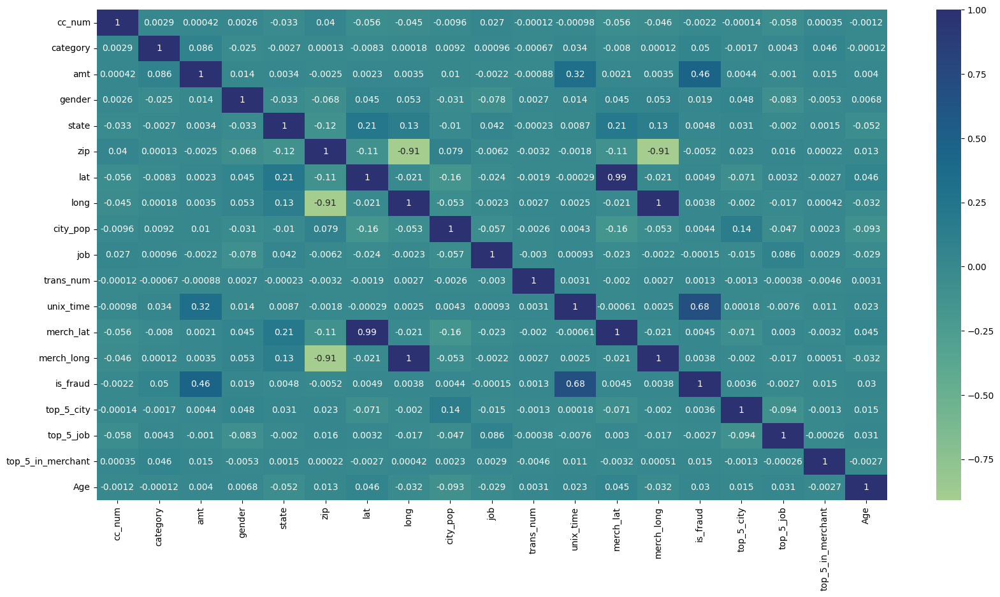

In [ ]:
# plot the correlation matrix of the dataset
plt.figure(figsize=(20,10))
sns.heatmap(data.corr(),annot=True,cmap="crest")

In [ ]:
import pandas as pd
import numpy as np
from scipy import stats

# Calculate Z-scores for a specific column (replace 'your_column' with the actual column name)
z_scores = np.abs(stats.zscore(data))

# Define threshold
threshold = 3

# Filter out the outliers
filtered_data = data[(z_scores < threshold)]

print(filtered_data)


               cc_num  category     amt  gender  state    zip      lat  \
0        2.703186e+15         8    4.97       0     27  28654  36.0788   
1        6.304233e+11         4  107.23       0     47  99160  48.8878   
2        3.885949e+13         0  220.11       1     13  83252  42.1808   
3        3.534094e+15         2   45.00       1     26  59632  46.2306   
4        3.755342e+14         9   41.96       1     45  24433  38.4207   
...               ...       ...     ...     ...    ...    ...      ...   
1295399  3.524575e+15        11     NaN       0      9  32960  27.6330   
1295491  3.524575e+15        11     NaN       0      9  32960  27.6330   
1295532  4.005677e+15         2   10.24       1     18  70726  30.4590   
1295666  3.560725e+15         2   21.69       0     43  79759  31.8599   
1295733  4.005677e+15         2   10.20       1     18  70726  30.4590   

             long  city_pop  job  trans_num     unix_time  merch_lat  \
0        -81.1781    3495.0  370       

<Axes: xlabel='category', ylabel='merch_lat'>

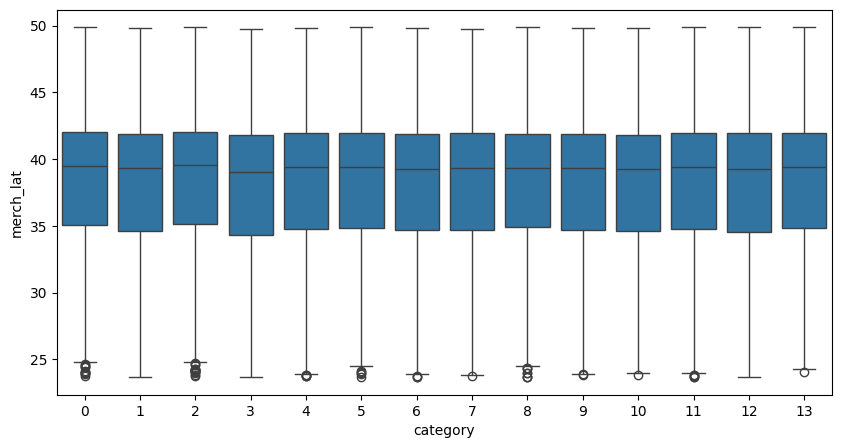

In [ ]:
# plot the box plot for the category and merch_lat
plt.figure(figsize=(10,5))

sns.boxplot(x='category',y='merch_lat',data=filtered_data)

In [ ]:
# checking the null values 
data.isnull().sum().sum()

0

In [ ]:
dfata = pd.DataFrame([data.columns])
dfata.to_csv('name.csv')

In [ ]:
data.columns

Index(['cc_num', 'category', 'amt', 'gender', 'state', 'zip', 'lat', 'long',
       'city_pop', 'job', 'trans_num', 'unix_time', 'merch_lat', 'merch_long',
       'is_fraud', 'top_5_city', 'top_5_job', 'top_5_in_merchant', 'Age'],
      dtype='object')

In [ ]:
columns = ['category', 'amt', 'gender', 'top_5_city','top_5_job', 'top_5_in_merchant', 'Age']

In [ ]:
data["is_fraud"].value_counts()

0    200000
1      7506
Name: is_fraud, dtype: int64

In [ ]:
x = data[columns]
y = data['is_fraud']

In [ ]:
y.value_counts().to_dict()

{0: 200000, 1: 7506}

**Here we balncing the data**

In [ ]:
from imblearn.over_sampling import SMOTE
sm = SMOTE()
# Resample the data
x_res, y_res = sm.fit_resample(x, y)


In [ ]:
y_res.value_counts().to_dict()

{0: 200000, 1: 200000}

In [ ]:
x_res.value_counts()

category  amt           gender  top_5_city  top_5_job  top_5_in_merchant  Age
2         9.360000      1       3           4          0                  46     19
10        19.240000     0       3           4          0                  50     18
4         300.930000    0       3           4          0                  71     15
          303.920000    1       3           4          0                  37     14
10        51.000000     0       3           4          0                  66     13
                                                                                 ..
4         316.941754    0       3           4          0                  89      1
          316.937754    0       3           4          0                  89      1
          316.937470    0       3           4          0                  85      1
          316.936520    1       3           4          0                  54      1
13        17897.240000  0       3           4          0                  26      

In [ ]:
x_res.shape,y_res.shape

((400000, 7), (400000,))

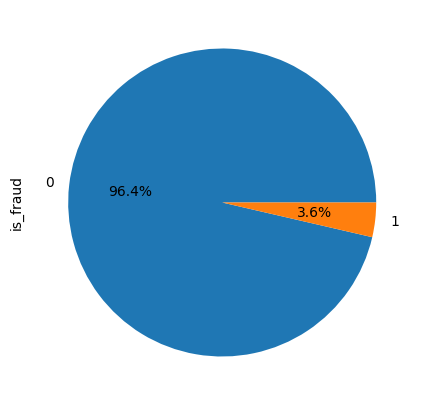

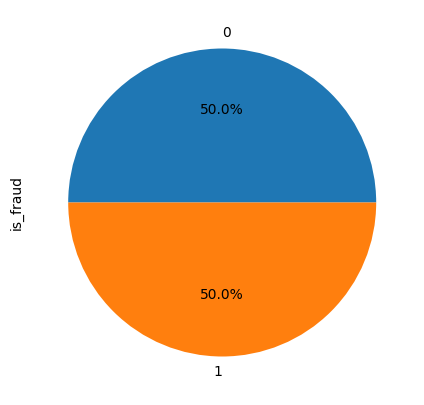

In [ ]:
# plot the pie plot for the y before and after applying the smote technique
# plot the pie plot for the y before and after applying the smote technique
plt.figure(figsize=(10,5))
y.value_counts().plot.pie(autopct='%1.1f%%')
plt.show()

plt.figure(figsize=(10,5))
y_res.value_counts().plot.pie(autopct='%1.1f%%')
plt.show()

In [ ]:
x_res

,category,amt,gender,top_5_city,top_5_job,top_5_in_merchant,Age
0,8,4.970000,0,3,4,0,36
1,4,107.230000,0,3,4,0,46
2,0,220.110000,1,3,4,0,62
3,2,45.000000,1,3,4,0,57
4,9,41.960000,1,3,4,0,38
...,...,...,...,...,...,...,...
399995,4,303.563403,1,3,4,0,33
399996,8,795.551171,0,3,4,0,81
399997,4,353.741253,0,3,4,0,51
399998,9,8.723066,0,3,4,0,33


In [ ]:
y_res.tail()

399995    1
399996    1
399997    1
399998    1
399999    1
Name: is_fraud, dtype: int64

In [ ]:
# splitting the data into training and testing part
from sklearn.model_selection import train_test_split
xtrain,xtest,ytrian,ytest = train_test_split(x_res,y_res,test_size=0.3,random_state=43 ,stratify = y_res)

In [ ]:
# printing the shape of the training and testing data
print(f'Here is the shape of the x_train {xtrain.shape}')
print(f'Here is the shape of the x_test {xtest.shape}')
print(f'Here is the shape of the y_train {ytrian.shape}')
print(f'Here is the shape of the y_test {ytest.shape}')

Here is the shape of the x_train (280000, 7)
Here is the shape of the x_test (120000, 7)
Here is the shape of the y_train (280000,)
Here is the shape of the y_test (120000,)


In [ ]:
# model building 
from sklearn.ensemble import StackingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
base_classifiers = [
    ('RF', RandomForestClassifier()),
    ('DTC', DecisionTreeClassifier())
]
final_estimator = LogisticRegression()

stacking_clf = StackingClassifier(
    estimators=base_classifiers,
    final_estimator=final_estimator,
    cv=5
)

In [ ]:
#here we fit the the to algoritham
stacking_clf.fit(xtrain,ytrian)

StackingClassifier(cv=5,
                   estimators=[('RF', RandomForestClassifier()),
                               ('DTC', DecisionTreeClassifier())],
                   final_estimator=LogisticRegression())

In [ ]:
#prediction of stacking classifier
stack_ypred=stacking_clf.predict(xtest)

In [ ]:
# importing the metrics for the evaluation of the model
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report, roc_auc_score, roc_curve,f1_score,precision_score,recall_score
# printing the accuracy score of the model
stack_test_ccuracy = accuracy_score(ytest, stack_ypred)
print(f'Accuracy: {stack_test_ccuracy}')

Accuracy: 0.9852666666666666


In [ ]:
recalll_stck = recall_score(ytest, stack_ypred)
print(f'recall_score: {recalll_stck}')

recall_score: 0.9872666666666666


In [ ]:
f1_score_stck = f1_score(ytest, stack_ypred)
print(f'f1_score: {f1_score_stck}')

f1_score: 0.9852960745176313


In [ ]:
precision_scorestck =precision_score(ytest, stack_ypred)
print(f'precision_score: {precision_scorestck}')

precision_score: 0.9833333333333333


In [ ]:
# printing the classification report of the model
print(f'Here is the classification report of the model \n \n {classification_report(ytest,stack_ypred)}')

Here is the classification report of the model 
 
               precision    recall  f1-score   support

           0       0.99      0.98      0.99     60000
           1       0.98      0.99      0.99     60000

    accuracy                           0.99    120000
   macro avg       0.99      0.99      0.99    120000
weighted avg       0.99      0.99      0.99    120000



In [ ]:
# printig the confusion matrix 
print(f'Here is the confusion matrix of the model \n \n {confusion_matrix(ytest,stack_ypred)}')

Here is the confusion matrix of the model 
 
 [[58996  1004]
 [  764 59236]]


<Axes: >

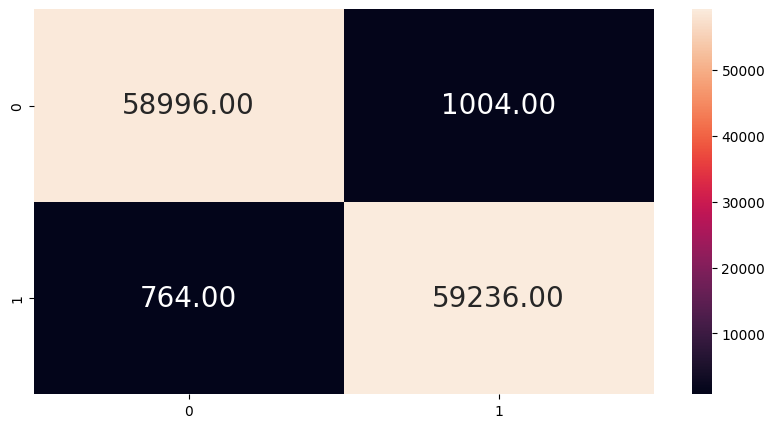

In [ ]:
# plot the confusion matrix
plt.figure(figsize=(10,5))

sns.heatmap(confusion_matrix(ytest,stack_ypred),annot=True,fmt='0.2f',annot_kws={'size':20})

In [ ]:
#printing the auc score of the model    
print(f'Here is the auc score of the model {roc_auc_score(ytest,stack_ypred)}')

Here is the auc score of the model 0.9852666666666666


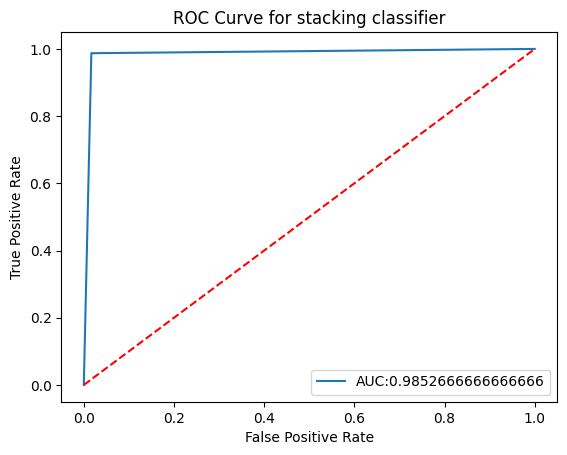

In [ ]:
# plot the roc curve for the model with roc score adn the model name inside the plot
fpr,tpr,thresholds = roc_curve(ytest,stack_ypred)
plt.plot(fpr,tpr,label=f'AUC:{roc_auc_score(ytest,stack_ypred)}')
plt.plot([0,1],[0,1],'k--',color='r')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for stacking classifier')
plt.legend(loc='lower right')
plt.show()

In [ ]:
stack_ypred_train=stacking_clf.predict(xtrain)
# printing the train accuracy score of the model
Train_accuracy = accuracy_score(ytrian, stack_ypred_train)
print(f'Accuracy: {Train_accuracy}')

Accuracy: 0.9999535714285714


In [ ]:
import lime
import lime.lime_tabular
import numpy as np


explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=np.array(xtrain),
    feature_names=xtrain.columns.tolist(),
    class_names=['No Fruad 0', 'Is Fraud 1'],  
    mode='classification'  
)


instance_index = 10
instance = xtrain.iloc[instance_index]

# Explain the prediction of this instance.
exp = explainer.explain_instance(
    data_row=instance,
    predict_fn=stacking_clf.predict_proba 
)

# Display the explanation. You can visualize it in a notebook.
exp.show_in_notebook(show_table=True, show_all=False)


## RandomForestClassifier

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier()

In [ ]:
rf.fit(xtrain,ytrian)

RandomForestClassifier()

In [ ]:
from sklearn.metrics import accuracy_score,f1_score,classification_report,confusion_matrix
pred = rf.predict(xtest)
##acc
print("Accuracy:", accuracy_score(ytest, pred))
## confusion matrix
print("Confusion Matrix:\n", confusion_matrix(ytest, pred))
## f1 score 
print("F1 Score:", f1_score(ytest, pred, average='macro'))
#classsification matrix
print("Classification Matrix:\n", classification_report(ytest, pred))

Accuracy: 0.9853166666666666
Confusion Matrix:
 [[58968  1032]
 [  730 59270]]
F1 Score: 0.9853165736675544
Classification Matrix:
               precision    recall  f1-score   support

           0       0.99      0.98      0.99     60000
           1       0.98      0.99      0.99     60000

    accuracy                           0.99    120000
   macro avg       0.99      0.99      0.99    120000
weighted avg       0.99      0.99      0.99    120000



In [ ]:
rf_precison = precision_score(ytest, pred)
print(f'precision score: {rf_precison}')

precision score: 0.982886139763192


In [ ]:
recalll_rf = recall_score(ytest, pred)
print(f'recall_score: {recalll_rf}')

recall_score: 0.9878333333333333


In [ ]:
# ## create the job lib file for front end
# import joblib
# joblib.dump(rf, "randomforest.joblib")

In [ ]:
import lime
import lime.lime_tabular
import numpy as np

explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=np.array(xtrain),
    feature_names=xtrain.columns.tolist(),
    class_names=['No Fruad 0', 'Is Fraud 1'],  
    mode='classification'  
)


instance_index = 10
instance = xtrain.iloc[instance_index]

# Explain the prediction of this instance.
exp = explainer.explain_instance(
    data_row=instance,
    predict_fn=rf.predict_proba 
)

# Display the explanation. You can visualize it in a notebook.
exp.show_in_notebook(show_table=True, show_all=False)


In [ ]:
from keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, Flatten, Dense
from keras.optimizers import Adam
from sklearn.model_selection import train_test_split

# Assuming xshample and yshample are your features and labels as DataFrames
xshample1 = x_res.to_numpy()  # Convert DataFrame to NumPy array
yshample1 = y_res.to_numpy()  # Convert DataFrame to NumPy array

# Splitting the data into training and testing parts
xtrain, xtest, ytrain, ytest = train_test_split(xshample1, yshample1, test_size=0.3, random_state=42)

# Reshape the data to fit Conv1D input requirements
xtrain1 = xtrain.reshape((xtrain.shape[0], xtrain.shape[1], 1))
xtest1 = xtest.reshape((xtest.shape[0], xtest.shape[1], 1))

# Define the CNN model
CNN = Sequential()

# Add Conv1D layers with a smaller kernel size
CNN.add(Conv1D(filters=64, kernel_size=2, activation='relu', input_shape=(xtrain1.shape[1], xtrain1.shape[2])))
CNN.add(MaxPooling1D(pool_size=2))

CNN.add(Conv1D(filters=128, kernel_size=2, activation='relu'))
CNN.add(MaxPooling1D(pool_size=2))

# Flatten the output from Conv1D layers
CNN.add(Flatten())

# Add Dense layers
CNN.add(Dense(64, activation='relu'))
CNN.add(Dense(1, activation='sigmoid'))  # Use 'softmax' if you have multiple classes

# Compile the model
CNN.compile(optimizer=Adam(learning_rate=0.001),
            loss='binary_crossentropy',  # Use 'sparse_categorical_crossentropy' for multiple classes
            metrics=['accuracy'])

# Train the model
history = CNN.fit(xtrain1, ytrain, epochs=10, batch_size=32, validation_split=0.2)


Epoch 1/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 22s 3ms/step - accuracy: 0.8719 - loss: 0.3519 - val_accuracy: 0.9317 - val_loss: 0.1702
Epoch 2/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 20s 3ms/step - accuracy: 0.9293 - loss: 0.1664 - val_accuracy: 0.9409 - val_loss: 0.1354
Epoch 3/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9414 - loss: 0.1379 - val_accuracy: 0.9388 - val_loss: 0.1449
Epoch 4/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 20s 3ms/step - accuracy: 0.9483 - loss: 0.1282 - val_accuracy: 0.9413 - val_loss: 0.1402
Epoch 5/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9518 - loss: 0.1200 - val_accuracy: 0.9513 - val_loss: 0.1258
Epoch 6/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 20s 3ms/step - accuracy: 0.9531 - loss: 0.1154 - val_accuracy: 0.9505 - val_loss: 0.1118
Epoch 7/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9555 - loss: 0.1119 - val_accuracy: 0.9554 - val_loss: 0.1116
Epoch 8/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 20s 3ms/step - accuracy: 0.9571 - loss: 0

In [ ]:
# Evaluate the model
test_loss, test_accuracy = CNN.evaluate(xtest1, ytest)
print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")


3750/3750 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.9633 - loss: 0.0930
Test Loss: 0.0930
Test Accuracy: 0.9635


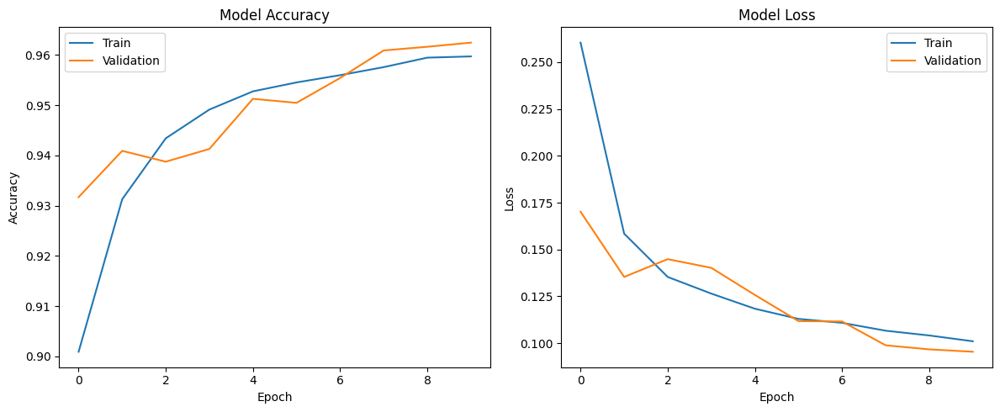

3750/3750 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step


In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.preprocessing import LabelBinarizer

# Assuming 'history' is the output from CNN.fit()
# Plot training & validation accuracy values
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'])

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'])

plt.tight_layout()
plt.show()

# Make predictions
y_pred = CNN.predict(xtest1)
y_pred_classes = (y_pred > 0.5).astype("int32")



<Figure size 800x600 with 0 Axes>

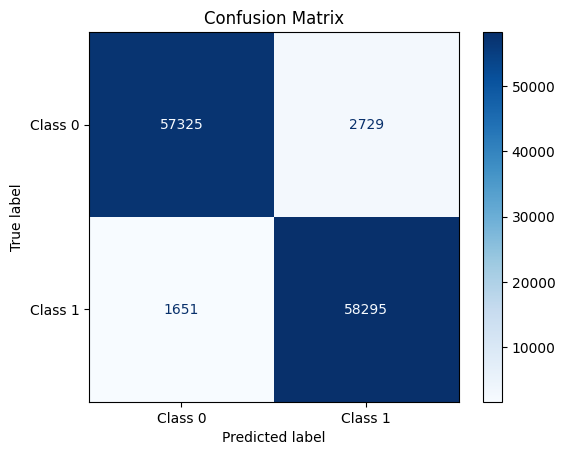

In [ ]:
# Compute confusion matrix
cm = confusion_matrix(ytest, y_pred_classes)
# Plot confusion matrix
plt.figure(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["Class 0", "Class 1"])
disp.plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.show()


In [ ]:
#import libraries for LSTm
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split

In [ ]:

xshample1 = x_res.to_numpy()  # Convert DataFrame to NumPy array
yshample1 = y_res.to_numpy()  # Convert DataFrame to NumPy arra
# Splitting the data into training and testing parts
xtrain, xtest, ytrain, ytest = train_test_split(xshample1, yshample1, test_size=0.3, random_state=42)

# Reshape the data to fit LSTM input requirements
xtrain1 = xtrain.reshape((xtrain.shape[0], xtrain.shape[1], 1))
xtest1 = xtest.reshape((xtest.shape[0], xtest.shape[1], 1))

# Define the LSTM model
lstm = Sequential()

# Add LSTM layers
lstm.add(LSTM(50, return_sequences=True, input_shape=(xtrain1.shape[1], xtrain1.shape[2])))
lstm.add(LSTM(50, return_sequences=False))

# Add Dense layers
lstm.add(Dense(64, activation='relu'))
lstm.add(Dense(1, activation='sigmoid'))  # Use 'softmax' if you have multiple classes

# Compile the model
lstm.compile(optimizer=Adam(learning_rate=0.001),
              loss='binary_crossentropy',  # Use 'sparse_categorical_crossentropy' for multiple classes
              metrics=['accuracy'])

# Train the model
history = lstm.fit(xtrain1, ytrain, epochs=10, batch_size=32, validation_split=0.2)


Epoch 1/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 32s 4ms/step - accuracy: 0.8879 - loss: 0.2562 - val_accuracy: 0.9399 - val_loss: 0.1437
Epoch 2/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 27s 4ms/step - accuracy: 0.9426 - loss: 0.1383 - val_accuracy: 0.9578 - val_loss: 0.1022
Epoch 3/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 28s 4ms/step - accuracy: 0.9549 - loss: 0.1113 - val_accuracy: 0.9646 - val_loss: 0.0905
Epoch 4/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 42s 4ms/step - accuracy: 0.9594 - loss: 0.1016 - val_accuracy: 0.9652 - val_loss: 0.0873
Epoch 5/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 28s 4ms/step - accuracy: 0.9626 - loss: 0.0939 - val_accuracy: 0.9669 - val_loss: 0.0868
Epoch 6/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 27s 4ms/step - accuracy: 0.9652 - loss: 0.0903 - val_accuracy: 0.9684 - val_loss: 0.0823
Epoch 7/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 29s 4ms/step - accuracy: 0.9666 - loss: 0.0863 - val_accuracy: 0.9653 - val_loss: 0.0889
Epoch 8/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 40s 4ms/step - accuracy: 0.9672 - loss: 0

In [ ]:
# Evaluate the model
test_loss, test_accuracy = lstm.evaluate(xtest1, ytest)
print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")

3750/3750 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9701 - loss: 0.0766
Test Loss: 0.0779
Test Accuracy: 0.9696


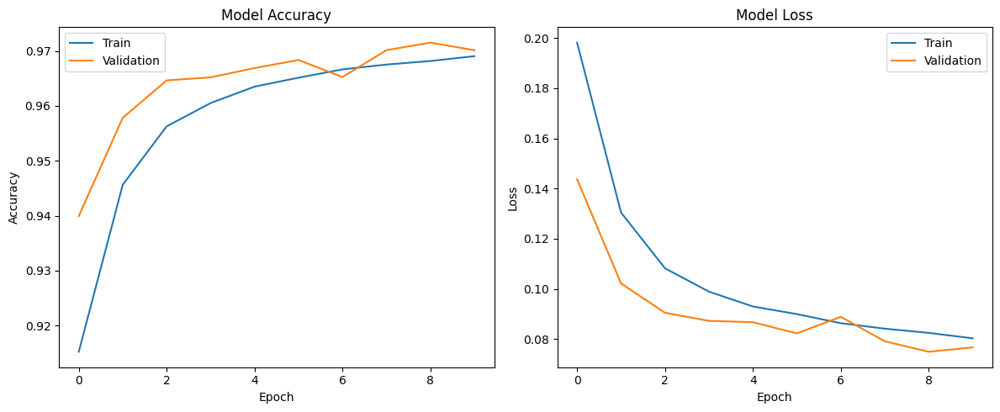

3750/3750 ━━━━━━━━━━━━━━━━━━━━ 8s 2ms/step


In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.preprocessing import LabelBinarizer

# Assuming 'history' is the output from CNN.fit()
# Plot training & validation accuracy values
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'])

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'])

plt.tight_layout()
plt.show()

# Make predictions
y_pred = lstm.predict(xtest1)
y_pred_classes = (y_pred > 0.5).astype("int32")



   1/3750 ━━━━━━━━━━━━━━━━━━━━ 2:10 35ms/step

3750/3750 ━━━━━━━━━━━━━━━━━━━━ 8s 2ms/step


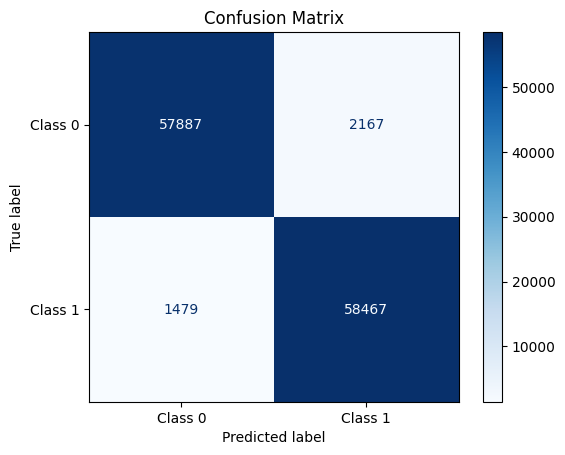

In [ ]:
# Make predictions
y_pred_probs = lstm.predict(xtest1)
y_pred = (y_pred_probs > 0.5).astype(int).flatten()  # Convert probabilities to binary class labels

# Compute confusion matrix
cm = confusion_matrix(ytest, y_pred)

# Plot confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Class 0', 'Class 1'])
disp.plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.show()

In [ ]:
# Evaluate the model
train_loss, train_accuracy = lstm.evaluate(xtrain1, ytrain)
print(f"Train Loss: {train_loss:.4f}")
print(f"Train Accuracy: {train_accuracy:.4f}")

  30/8750 ━━━━━━━━━━━━━━━━━━━━ 32s 4ms/step - accuracy: 0.9699 - loss: 0.0764 

8750/8750 ━━━━━━━━━━━━━━━━━━━━ 17s 2ms/step - accuracy: 0.9700 - loss: 0.0771
Train Loss: 0.0769
Train Accuracy: 0.9700


In [ ]:
xtrain, xtest, ytrain, ytest = train_test_split(x_res, y_res, test_size=0.3, random_state=42)

In [ ]:
from sklearn.feature_selection import mutual_info_classif
# determine the mutual information
mutual_info = mutual_info_classif(xtrain, ytrain)
mutual_info

array([0.1058345 , 0.55773374, 0.02432625, 0.03298243, 0.04433128,
       0.00239797, 0.01844943])

In [ ]:
xtrain.head()

,category,amt,gender,top_5_city,top_5_job,top_5_in_merchant,Age
300913,4,349.568575,0,3,4,0,43
99681,9,89.180000,0,3,4,0,65
150188,10,35.290000,0,3,4,0,43
205660,4,274.280000,1,3,4,0,49
47560,1,66.260000,1,3,4,0,96


In [ ]:
xtrain.columns

Index(['category', 'amt', 'gender', 'top_5_city', 'top_5_job',
       'top_5_in_merchant', 'Age'],
      dtype='object')

In [ ]:
mutual_info = pd.Series(mutual_info)
mutual_info.index = xtrain.columns
mutual_info.sort_values(ascending=False)

amt                  0.557734
category             0.105834
top_5_job            0.044331
top_5_city           0.032982
gender               0.024326
Age                  0.018449
top_5_in_merchant    0.002398
dtype: float64

<Axes: >

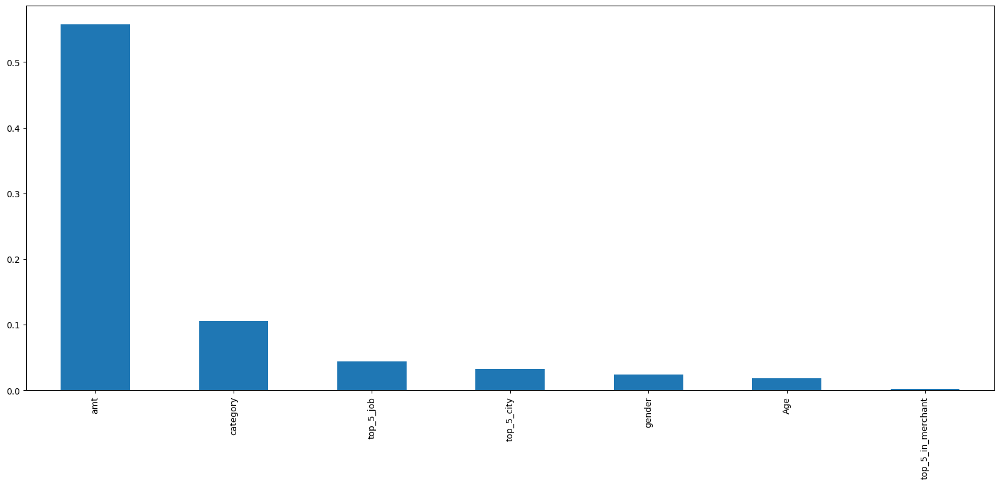

In [ ]:
#let's plot the ordered mutual_info values per feature
mutual_info.sort_values(ascending=False).plot.bar(figsize=(20, 8))

In [ ]:
#import the libraries
from sklearn.feature_selection import SelectKBest
#No we Will select the  top 8 important features
sel_eight_cols = SelectKBest(mutual_info_classif, k=7)
sel_eight_cols.fit(xtrain, ytrain)
xtrain.columns[sel_eight_cols.get_support()]

Index(['category', 'amt', 'gender', 'top_5_city', 'top_5_job',
       'top_5_in_merchant', 'Age'],
      dtype='object')

In [ ]:
xtrain=xtrain[['category', 'amt', 'gender', 'top_5_city', 'top_5_job',
       'top_5_in_merchant', 'Age']]

In [ ]:
xtest=xtest[['category', 'amt', 'gender', 'top_5_city', 'top_5_job',
       'top_5_in_merchant', 'Age']]

## After K-best  StackingClassifier

In [ ]:
from sklearn.ensemble import StackingClassifier, RandomForestClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression

# Define base classifiers
base_classifiers = [
    ('rf', RandomForestClassifier(n_estimators=50, random_state=42)),
    ('gb', GradientBoostingClassifier(n_estimators=50, random_state=42)),
    ('knn', KNeighborsClassifier())
]

# Define meta-classifier
meta_classifier = LogisticRegression()

# Create and train stacking classifier
stacking_clf = StackingClassifier(estimators=base_classifiers, final_estimator=meta_classifier)


In [ ]:
stacking_clf.fit(xtrain, ytrain)

StackingClassifier(estimators=[('rf',
                                RandomForestClassifier(n_estimators=50,
                                                       random_state=42)),
                               ('gb',
                                GradientBoostingClassifier(n_estimators=50,
                                                           random_state=42)),
                               ('knn', KNeighborsClassifier())],
                   final_estimator=LogisticRegression())

In [ ]:
#prediction of stacking classifier
stack_ypred=stacking_clf.predict(xtest)

In [ ]:
# importing the metrics for the evaluation of the model
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report, roc_auc_score, roc_curve,f1_score,precision_score,recall_score
# printing the accuracy score of the model
stack_test_ccuracy = accuracy_score(ytest, stack_ypred)
print(f'Accuracy: {stack_test_ccuracy}')

Accuracy: 0.9856083333333333


In [ ]:
stack_k_test_accuracy = f1_score(ytest, stack_ypred)
print(f'f1 score: {stack_k_test_accuracy}')
stack_k_precison = precision_score(ytest, stack_ypred)
print(f'precision score: {stack_k_precison}')
recalll_stack_k_ = recall_score(ytest, stack_ypred)
print(f'recall_score: {recalll_stack_k_}')

f1 score: 0.9856355061674998
precision score: 0.9828967668087789
recall_score: 0.988389550595536


In [ ]:
# printing the classification report of the model
print(f'Here is the classification report of the model \n \n {classification_report(ytest,stack_ypred)}')

Here is the classification report of the model 
 
               precision    recall  f1-score   support

           0       0.99      0.98      0.99     60054
           1       0.98      0.99      0.99     59946

    accuracy                           0.99    120000
   macro avg       0.99      0.99      0.99    120000
weighted avg       0.99      0.99      0.99    120000



In [ ]:
# printig the confusion matrix 
print(f'Here is the confusion matrix of the model \n \n {confusion_matrix(ytest,stack_ypred)}')

Here is the confusion matrix of the model 
 
 [[59023  1031]
 [  696 59250]]


<Axes: >

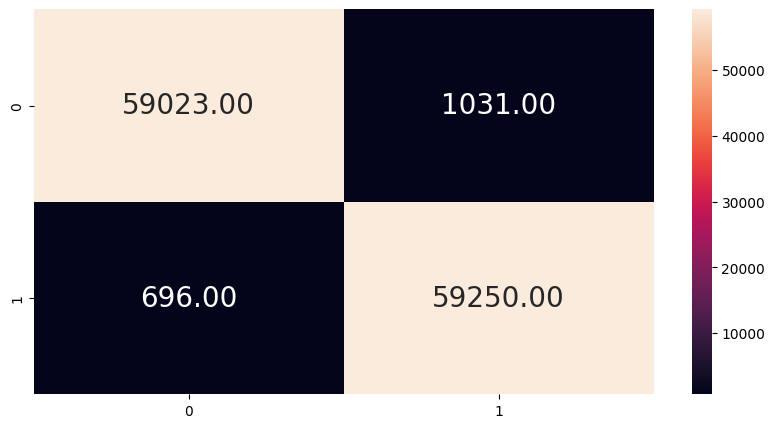

In [ ]:
# plot the confusion matrix
plt.figure(figsize=(10,5))

sns.heatmap(confusion_matrix(ytest,stack_ypred),annot=True,fmt='0.2f',annot_kws={'size':20})

In [ ]:
#printing the auc score of the model    
print(f'Here is the auc score of the model {roc_auc_score(ytest,stack_ypred)}')

Here is the auc score of the model 0.9856108341781089


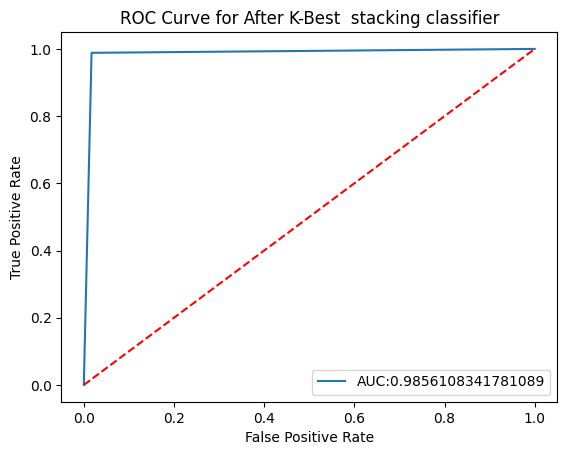

In [ ]:
# plot the roc curve for the model with roc score adn the model name inside the plot
fpr,tpr,thresholds = roc_curve(ytest,stack_ypred)
plt.plot(fpr,tpr,label=f'AUC:{roc_auc_score(ytest,stack_ypred)}')
plt.plot([0,1],[0,1],'k--',color='r')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for After K-Best  stacking classifier')
plt.legend(loc='lower right')
plt.show()

In [ ]:
#train data accuracy
stack_ypred_train=stacking_clf.predict(xtrain)
# printing the train accuracy score of the model
Train_accuracy = accuracy_score(ytrain, stack_ypred_train)
print(f'Accuracy: {Train_accuracy}')

Accuracy: 0.9975178571428571


In [ ]:
import lime
import lime.lime_tabular
import numpy as np


explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=np.array(xtrain),
    feature_names=xtrain.columns.tolist(),
    class_names=['No Fruad 0', 'Is Fraud 1'],  
    mode='classification'  
)


instance_index = 10
instance = xtrain.iloc[instance_index]

# Explain the prediction of this instance.
exp = explainer.explain_instance(
    data_row=instance,
    predict_fn=stacking_clf.predict_proba 
)

# Display the explanation. You can visualize it in a notebook.
exp.show_in_notebook(show_table=True, show_all=False)


## Ofter K-best  RandomForestClassifier

In [ ]:
##**RandomForestClassifier**
from sklearn.ensemble import RandomForestClassifier
rf=RandomForestClassifier(random_state=42)
rf.fit(xtrain,ytrain)

RandomForestClassifier(random_state=42)

In [ ]:
rf_ypred=rf.predict(xtest)
# importing the metrics for the evaluation of the model
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report, roc_auc_score, roc_curve
# printing the accuracy sco
# re of the model
dtc_test_accuracy = accuracy_score(ytest, rf_ypred)
print(f'dtc test is Accuracy: {dtc_test_accuracy}')

dtc test is Accuracy: 0.9852583333333333


In [ ]:
sdtc_ypred_train=rf.predict(xtrain)
# printing the train accuracy score of the model
Train_dtc_accuracy = accuracy_score(ytrain, sdtc_ypred_train)
print(f'Accuracy: {Train_dtc_accuracy}')

Accuracy: 0.9999678571428572


In [ ]:
# printing the classification report of the model
print(f'Here is the classification report of the model \n \n {classification_report(ytest,rf_ypred)}')

Here is the classification report of the model 
 
               precision    recall  f1-score   support

           0       0.99      0.98      0.99     60054
           1       0.98      0.99      0.99     59946

    accuracy                           0.99    120000
   macro avg       0.99      0.99      0.99    120000
weighted avg       0.99      0.99      0.99    120000



In [ ]:
# printig the confusion matrix 
print(f'Here is the confusion matrix of the model \n \n {confusion_matrix(ytest,rf_ypred)}')

Here is the confusion matrix of the model 
 
 [[58978  1076]
 [  693 59253]]


<Axes: >

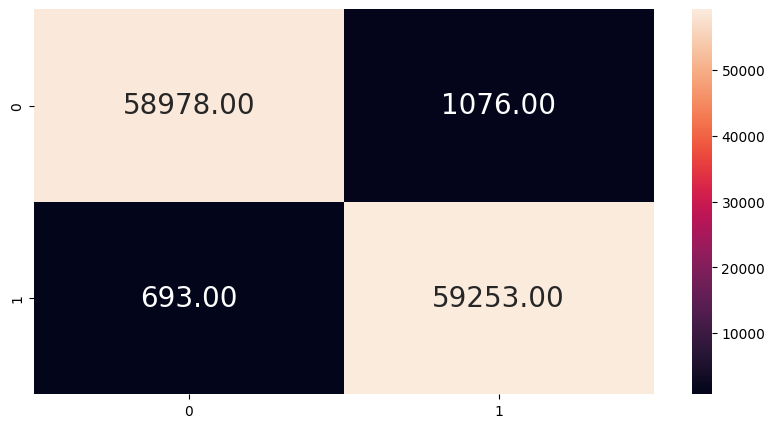

In [ ]:
# plot the confusion matrix
plt.figure(figsize=(10,5))

sns.heatmap(confusion_matrix(ytest,rf_ypred),annot=True,fmt='0.2f',annot_kws={'size':20})

In [ ]:
#printing the auc score of the model    
print(f'Here is the auc score of the model {roc_auc_score(ytest,rf_ypred)}')

Here is the auc score of the model 0.9852611938949004


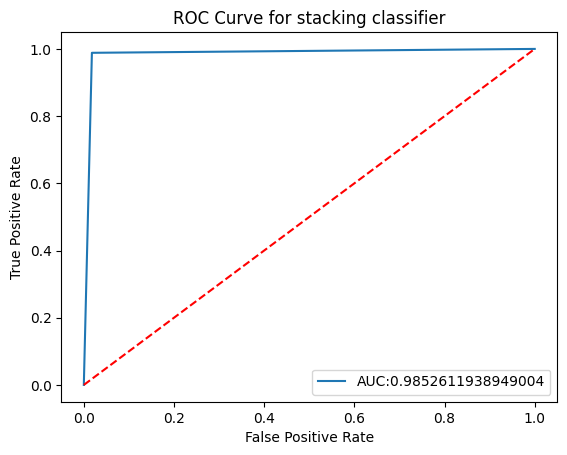

In [ ]:
# plot the roc curve for the model with roc score adn the model name inside the plot
fpr,tpr,thresholds = roc_curve(ytest,rf_ypred)
plt.plot(fpr,tpr,label=f'AUC:{roc_auc_score(ytest,rf_ypred)}')
plt.plot([0,1],[0,1],'k--',color='r')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for stacking classifier')
plt.legend(loc='lower right')
plt.show()

In [ ]:
import lime
import lime.lime_tabular
import numpy as np

explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=np.array(xtrain),
    feature_names=xtrain.columns.tolist(),
    class_names=['No Fruad 0', 'Is Fraud 1'],  
    mode='classification'  
)


instance_index = 10
instance = xtrain.iloc[instance_index]

# Explain the prediction of this instance.
exp = explainer.explain_instance(
    data_row=instance,
    predict_fn=rf.predict_proba 
)

# Display the explanation. You can visualize it in a notebook.
exp.show_in_notebook(show_table=True, show_all=False)


In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split

# Assuming xshample and yshample are your features and labels as DataFrames
xshample1 = x_res.to_numpy()  # Convert DataFrame to NumPy array
yshample1 = y_res.to_numpy()  # Convert DataFrame to NumPy array

# Splitting the data into training and testing parts


# Splitting the data into training and testing parts
xtrain, xtest, ytrain, ytest = train_test_split(xshample1, yshample1, test_size=0.3, random_state=42)

# Reshape the data to fit LSTM input requirements
xtrain1 = xtrain.reshape((xtrain.shape[0], xtrain.shape[1], 1))
xtest1 = xtest.reshape((xtest.shape[0], xtest.shape[1], 1))

# Define the LSTM model
lstm = Sequential()

# Add LSTM layers
lstm.add(LSTM(50, return_sequences=True, input_shape=(xtrain1.shape[1], xtrain1.shape[2])))
lstm.add(LSTM(50, return_sequences=False))

# Add Dense layers
lstm.add(Dense(64, activation='relu'))
lstm.add(Dense(1, activation='sigmoid'))  # Use 'softmax' if you have multiple classes

# Compile the model
lstm.compile(optimizer=Adam(learning_rate=0.001),
              loss='binary_crossentropy',  # Use 'sparse_categorical_crossentropy' for multiple classes
              metrics=['accuracy'])

# Train the model
history = lstm.fit(xtrain1, ytrain, epochs=10, batch_size=32, validation_split=0.2)

# Evaluate the model
loss, accuracy = lstm.evaluate(xtest1, ytest)
print(f'Test Accuracy: {accuracy * 100:.2f}%')


Epoch 1/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 33s 4ms/step - accuracy: 0.8872 - loss: 0.2552 - val_accuracy: 0.9359 - val_loss: 0.1411
Epoch 2/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 40s 4ms/step - accuracy: 0.9461 - loss: 0.1311 - val_accuracy: 0.9564 - val_loss: 0.1026
Epoch 3/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 30s 4ms/step - accuracy: 0.9582 - loss: 0.1049 - val_accuracy: 0.9615 - val_loss: 0.0951
Epoch 4/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 30s 4ms/step - accuracy: 0.9619 - loss: 0.0972 - val_accuracy: 0.9672 - val_loss: 0.0843
Epoch 5/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 30s 4ms/step - accuracy: 0.9640 - loss: 0.0931 - val_accuracy: 0.9635 - val_loss: 0.0941
Epoch 6/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 29s 4ms/step - accuracy: 0.9653 - loss: 0.0885 - val_accuracy: 0.9637 - val_loss: 0.0916
Epoch 7/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 31s 4ms/step - accuracy: 0.9655 - loss: 0.0885 - val_accuracy: 0.9668 - val_loss: 0.0889
Epoch 8/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 32s 5ms/step - accuracy: 0.9679 - loss: 0

In [ ]:
# Evaluate the model
test_loss, test_accuracy = lstm.evaluate(xtest1, ytest)
print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")

3750/3750 ━━━━━━━━━━━━━━━━━━━━ 9s 2ms/step - accuracy: 0.9695 - loss: 0.0780
Test Loss: 0.0786
Test Accuracy: 0.9698


3750/3750 ━━━━━━━━━━━━━━━━━━━━ 8s 2ms/step


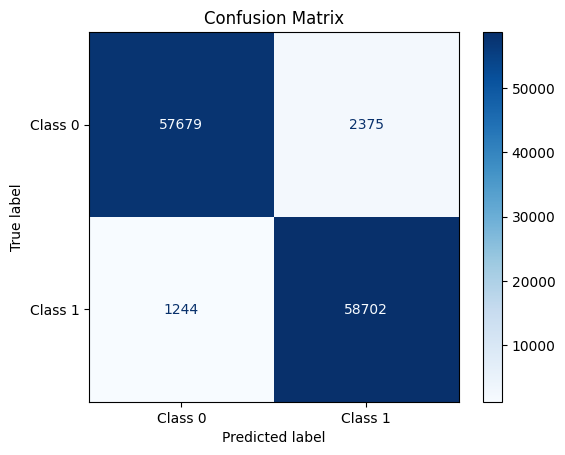

In [ ]:
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay
# Make predictions
y_pred_probs = lstm.predict(xtest1)
y_pred = (y_pred_probs > 0.5).astype(int).flatten()  # Convert probabilities to binary class labels

# Compute confusion matrix
cm = confusion_matrix(ytest, y_pred)

# Plot confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Class 0', 'Class 1'])
disp.plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.show()

In [ ]:
# Evaluate the model
train_loss, train_accuracy = lstm.evaluate(xtrain1, ytrain)
print(f"Train Loss: {train_loss:.4f}")
print(f"Train Accuracy: {train_accuracy:.4f}")

8750/8750 ━━━━━━━━━━━━━━━━━━━━ 17s 2ms/step - accuracy: 0.9698 - loss: 0.0785
Train Loss: 0.0781
Train Accuracy: 0.9698


In [ ]:
from keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, Flatten, Dense
from keras.optimizers import Adam
from sklearn.model_selection import train_test_split

# Assuming xshample and yshample are your features and labels as DataFrames
xshample1 = x_res.to_numpy()  # Convert DataFrame to NumPy array
yshample1 = y_res.to_numpy()  # Convert DataFrame to NumPy array

# Splitting the data into training and testing parts
xtrain, xtest, ytrain, ytest = train_test_split(xshample1, yshample1, test_size=0.3, random_state=42)

# Reshape the data to fit Conv1D input requirements
xtrain1 = xtrain.reshape((xtrain.shape[0], xtrain.shape[1], 1))
xtest1 = xtest.reshape((xtest.shape[0], xtest.shape[1], 1))

# Define the CNN model
CNN = Sequential()

# Add Conv1D layers with a smaller kernel size
CNN.add(Conv1D(filters=64, kernel_size=2, activation='relu', input_shape=(xtrain1.shape[1], xtrain1.shape[2])))
CNN.add(MaxPooling1D(pool_size=2))

CNN.add(Conv1D(filters=128, kernel_size=2, activation='relu'))
CNN.add(MaxPooling1D(pool_size=2))

# Flatten the output from Conv1D layers
CNN.add(Flatten())

# Add Dense layers
CNN.add(Dense(64, activation='relu'))
CNN.add(Dense(1, activation='sigmoid'))  # Use 'softmax' if you have multiple classes

# Compile the model
CNN.compile(optimizer=Adam(learning_rate=0.001),
            loss='binary_crossentropy',  # Use 'sparse_categorical_crossentropy' for multiple classes
            metrics=['accuracy'])

# Train the model
history = CNN.fit(xtrain1, ytrain, epochs=10, batch_size=32, validation_split=0.2)


Epoch 1/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 20s 3ms/step - accuracy: 0.8700 - loss: 0.3775 - val_accuracy: 0.9290 - val_loss: 0.1809
Epoch 2/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9302 - loss: 0.1734 - val_accuracy: 0.9469 - val_loss: 0.1331
Epoch 3/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9456 - loss: 0.1357 - val_accuracy: 0.9491 - val_loss: 0.1197
Epoch 4/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9505 - loss: 0.1241 - val_accuracy: 0.9509 - val_loss: 0.1179
Epoch 5/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 19s 3ms/step - accuracy: 0.9548 - loss: 0.1137 - val_accuracy: 0.9523 - val_loss: 0.1254
Epoch 6/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9554 - loss: 0.1105 - val_accuracy: 0.9581 - val_loss: 0.1067
Epoch 7/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9580 - loss: 0.1058 - val_accuracy: 0.9578 - val_loss: 0.1049
Epoch 8/10
7000/7000 ━━━━━━━━━━━━━━━━━━━━ 18s 3ms/step - accuracy: 0.9596 - loss: 0

In [ ]:
# Evaluate the model
test_loss, test_accuracy = CNN.evaluate(xtest1, ytest)
print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")


3750/3750 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.9636 - loss: 0.0915
Test Loss: 0.0918
Test Accuracy: 0.9637


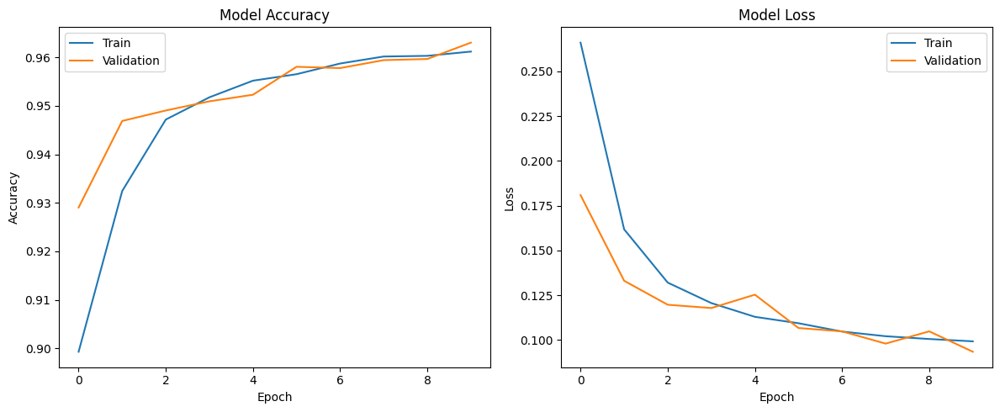

3750/3750 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step


In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.preprocessing import LabelBinarizer

# Assuming 'history' is the output from CNN.fit()
# Plot training & validation accuracy values
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'])

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'])

plt.tight_layout()
plt.show()

# Make predictions
y_pred = CNN.predict(xtest1)
y_pred_classes = (y_pred > 0.5).astype("int32")



<Figure size 800x600 with 0 Axes>

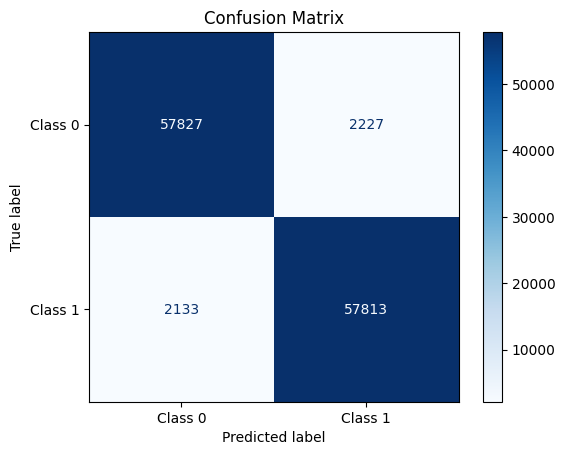

In [ ]:
# Compute confusion matrix
cm = confusion_matrix(ytest, y_pred_classes)
# Plot confusion matrix
plt.figure(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["Class 0", "Class 1"])
disp.plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.show()


In [ ]:
"""Title :-PREDICTING CREDIT CARD FRAUD DETECTION USING MACHINE LEARNING
======================================================
abstrct :- Credit card fraud detection remains a critical concern for financial institutions due to the increasing sophistication of fraudulent activities. This study addresses this challenge by leveraging machine learning algorithms to enhance the accuracy and efficiency of fraud detection systems. Utilizing a dataset from Kaggle, we implement and compare five distinct algorithms: Convolutional Neural Networks (CNN), Long Short-Term Memory networks (LSTM), Decision Trees, Random Forests, and a Stacking Classifier. CNNs are employed to capture intricate patterns in transaction data, while LSTMs address sequential dependencies  and temporal dynamics. Decision Trees and Random Forests provide robust classification through hierarchical decision-making and ensemble learning. Additionally, a Stacking Classifier integrates the strengths of these algorithms to potentially improve overall performance. The comparative analysis of these methods aims to identify the most effective approach for real-time fraud detection. The results are expected to contribute significantly to the development of more secure credit card transaction systems, thereby mitigating financial losses and enhancing consumer trust.

==================================
give me the Peculiarity of This Project   in 300 words with Zero%  Palgarisam"""

'Title :-PREDICTING CREDIT CARD FRAUD DETECTION USING MACHINE LEARNING\n======================================================\nabstrct :- Credit card fraud detection remains a critical concern for financial institutions due to the increasing sophistication of fraudulent activities. This study addresses this challenge by leveraging machine learning algorithms to enhance the accuracy and efficiency of fraud detection systems. Utilizing a dataset from Kaggle, we implement and compare five distinct algorithms: Convolutional Neural Networks (CNN), Long Short-Term Memory networks (LSTM), Decision Trees, Random Forests, and a Stacking Classifier. CNNs are employed to capture intricate patterns in transaction data, while LSTMs address sequential dependencies  and temporal dynamics. Decision Trees and Random Forests provide robust classification through hierarchical decision-making and ensemble learning. Additionally, a Stacking Classifier integrates the strengths of these algorithms to potent

In [ ]:
# To inverse transform the data
inverse_transformed_data = pd.DataFrame()

for column, le in label_encoders.items():
    inverse_transformed_data[column] = le.inverse_transform(data[column])

# Display inverse transformed data
print("\nInverse Transformed DataFrame:")
print(inverse_transformed_data)


Inverse Transformed DataFrame:
             category gender state                                job  \
0            misc_net      F    NC          Psychologist, counselling   
1         grocery_pos      F    WA  Special educational needs teacher   
2       entertainment      M    ID        Nature conservation officer   
3       gas_transport      M    MT                    Patent attorney   
4            misc_pos      M    VA     Dance movement psychotherapist   
...               ...    ...   ...                                ...   
207501   shopping_net      F    FL                  Librarian, public   
207502   shopping_net      F    FL                  Librarian, public   
207503  gas_transport      M    LA                          Herbalist   
207504  gas_transport      F    TX                     Cytogeneticist   
207505  gas_transport      M    LA                          Herbalist   

                               trans_num top_5_city top_5_job  \
0       0b242abb623afc5785